# Étude progressive des réseaux de neurones sur le jeu de données HAR - Partie 2

## Importation des packages 

In [1]:
import os
import torch
import numpy as np
import pandas as pd
import torch.nn as nn
import seaborn as sns
import umap.umap_ as umap
import torch.optim as optim
import matplotlib.pyplot as plt
import torch.nn.functional as F
from sklearn.manifold import TSNE 
from sklearn.model_selection import train_test_split
from torch.utils.data import TensorDataset, DataLoader
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix

In [2]:
def set_seed(seed=0):
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)

set_seed(0)
device = "cuda" if torch.cuda.is_available() else "cpu"
print("Device:", device)

Device: cpu


## Partie 3 : Extension de l’architecture

### 1.1. Chargement et aperçu des données

In [3]:
train = pd.read_csv("./HAR/train.csv")

In [4]:
# Encodage de la variable cible 'Activity'

# Encodage des labels
label_encoder = LabelEncoder()
train['Activity_encoded'] = label_encoder.fit_transform(train['Activity'])

In [5]:
# Vérification
label_mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))
print("Mapping des classes :")
print(label_mapping)

Mapping des classes :
{'LAYING': np.int64(0), 'SITTING': np.int64(1), 'STANDING': np.int64(2), 'WALKING': np.int64(3), 'WALKING_DOWNSTAIRS': np.int64(4), 'WALKING_UPSTAIRS': np.int64(5)}


In [6]:
# Séparation des colonnes explicatives (X) et la variable cible (y)

X_train = train.drop(columns=['Activity', 'Activity_encoded', 'subject'])
y_train = train['Activity_encoded']

print(f"Dimensions des features (train) : {X_train.shape}")
print(f"Dimensions des labels   (train) : {y_train.shape}")

Dimensions des features (train) : (7352, 561)
Dimensions des labels   (train) : (7352,)


In [7]:
# Séparation en jeu d'entrainement et de validation

X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.2, random_state=42, shuffle=True)

In [8]:
# Standardisation des variables

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_valid_scaled = scaler.transform(X_valid)

print("Aperçu après standardisation :")
print(X_train_scaled[:3, :5])

Aperçu après standardisation :
[[ 0.0484155  -0.00190694  0.0042624  -0.86909332 -0.96650283]
 [-0.52681746  0.39917214 -0.09072664  0.61910154  1.15388967]
 [ 0.23238315 -0.78128154  0.61522408  1.28760696  0.95106806]]


In [9]:
# Conversion en tenseurs PyTorch

X_train_tensor = torch.tensor(X_train_scaled, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train.values, dtype=torch.long)

X_valid_tensor = torch.tensor(X_valid_scaled, dtype=torch.float32)
y_valid_tensor = torch.tensor(y_valid.values, dtype=torch.long)
 
print(f"Tensor features (train) : {X_train_tensor.shape}")
print(f"Tensor labels   (train) : {y_train_tensor.shape}")

Tensor features (train) : torch.Size([5881, 561])
Tensor labels   (train) : torch.Size([5881])


In [10]:
# Création des DataLoaders

batch_size = 64

train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
valid_dataset  = TensorDataset(X_valid_tensor, y_valid_tensor)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
valid_loader  = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False)

print(f"Nombre de batchs d'entraînement : {len(train_loader)}")
print(f"Nombre de batchs de validation        : {len(valid_loader)}")

Nombre de batchs d'entraînement : 92
Nombre de batchs de validation        : 23


In [11]:
# Vérification d’un mini-batch
for X_batch, y_batch in train_loader:
    print(f"Batch X : {X_batch.shape}, Batch y : {y_batch.shape}")
    break

Batch X : torch.Size([64, 561]), Batch y : torch.Size([64])


In [88]:
# Mise en place du réseau MLP simple

class MLP_1Hidden(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim, activation="relu"):
        super(MLP_1Hidden, self).__init__()
        
        self.fc1 = nn.Linear(input_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, output_dim)
        
        # Choix de la fonction d’activation
        if activation == "relu":
            self.activation = nn.ReLU()
        elif activation == "sigmoid":
            self.activation = nn.Sigmoid()
        elif activation == "tanh":
            self.activation = nn.Tanh()
        else:
            raise ValueError("Activation non reconnue. Choisir parmi 'relu', 'sigmoid', 'tanh'.")
    
    def forward(self, x):
        x = self.fc1(x)
        x = self.activation(x)
        x = self.fc2(x)  
        return x

In [89]:
input_dim = X_train_tensor.shape[1]
hidden_dim = 64
output_dim = len(label_encoder.classes_)

# Exemple avec ReLU et Adam
model = MLP_1Hidden(input_dim, hidden_dim, output_dim, activation="relu")

criterion = nn.CrossEntropyLoss()

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

print(model)

MLP_1Hidden(
  (fc1): Linear(in_features=561, out_features=64, bias=True)
  (fc2): Linear(in_features=64, out_features=6, bias=True)
  (activation): ReLU()
)


In [90]:
def train_model(model, criterion, optimizer, train_loader, test_loader, epochs=30, device='cpu'):
    model.to(device)
    history = {"train_loss": [], "test_loss": [], "train_acc": [], "test_acc": [], "f1_macro": []}
    
    for epoch in range(epochs):
        # Entraînement 
        model.train()
        running_loss, running_correct = 0.0, 0
        
        for X_batch, y_batch in train_loader:
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
            
            optimizer.zero_grad()
            outputs = model(X_batch)
            loss = criterion(outputs, y_batch)
            loss.backward()
            optimizer.step()
            
            running_loss += loss.item() * X_batch.size(0)
            preds = outputs.argmax(1)
            running_correct += (preds == y_batch).sum().item()
        
        train_loss = running_loss / len(train_loader.dataset)
        train_acc = running_correct / len(train_loader.dataset)
        
        # Evaluation 
        model.eval()
        test_loss, test_correct = 0.0, 0
        y_true, y_pred = [], []
        
        with torch.no_grad():
            for X_batch, y_batch in test_loader:
                X_batch, y_batch = X_batch.to(device), y_batch.to(device)
                outputs = model(X_batch)
                loss = criterion(outputs, y_batch)
                test_loss += loss.item() * X_batch.size(0)
                preds = outputs.argmax(1)
                test_correct += (preds == y_batch).sum().item()
                y_true.extend(y_batch.cpu().numpy())
                y_pred.extend(preds.cpu().numpy())
        
        test_loss /= len(test_loader.dataset)
        test_acc = test_correct / len(test_loader.dataset)
        f1_macro = f1_score(y_true, y_pred, average='macro')
        
        # Sauvegarde
        history["train_loss"].append(train_loss)
        history["test_loss"].append(test_loss)
        history["train_acc"].append(train_acc)
        history["test_acc"].append(test_acc)
        history["f1_macro"].append(f1_macro)
        
        print(f"Epoch [{epoch+1}/{epochs}]  "
              f"Train Loss: {train_loss:.4f}  Test Loss: {test_loss:.4f}  "
              f"Train Acc: {train_acc:.4f}  Test Acc: {test_acc:.4f}  F1: {f1_macro:.4f}")
    
    return history

In [91]:
# Expérimentations : taille de couche × activation × optimiseur

hidden_sizes = [128, 256]
activations = ["relu", "tanh", "sigmoid"]
optimizers = ["adam", "sgd", "sgd_momentum"]

experiments = {}
summary_rows = []

for h in hidden_sizes:
    for act in activations:
        for opt_name in optimizers:
            print("="*80)
            print(f"Expérience : hidden={h}, activation={act}, optimiseur={opt_name}")
            
            # Modèle
            model = MLP_1Hidden(input_dim, h, output_dim, activation=act)
            
            # Optimiseur
            if opt_name == "adam":
                optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
            elif opt_name == "sgd":
                optimizer = torch.optim.SGD(model.parameters(), lr=1e-2)
            elif opt_name == "sgd_momentum":
                optimizer = torch.optim.SGD(model.parameters(), lr=1e-2, momentum=0.9)
            
            # Entraînement
            history = train_model(model, criterion, optimizer, train_loader, valid_loader, epochs=30, device=device)
            
            # Sauvegarde
            experiments[(h, act, opt_name)] = history
            
            # Récupération des meilleures performances
            best_epoch = np.argmax(history["test_acc"])
            summary_rows.append({
                "Hidden": h,
                "Activation": act,
                "Optimiseur": opt_name,
                "Epoch*": best_epoch+1,
                "Train Acc": history["train_acc"][best_epoch],
                "Test Acc": history["test_acc"][best_epoch],
                "F1 Macro": history["f1_macro"][best_epoch],
                "Test Loss": history["test_loss"][best_epoch]
            })

Expérience : hidden=128, activation=relu, optimiseur=adam
Epoch [1/30]  Train Loss: 0.3970  Test Loss: 0.1744  Train Acc: 0.8616  Test Acc: 0.9497  F1: 0.9508
Epoch [2/30]  Train Loss: 0.1245  Test Loss: 0.1202  Train Acc: 0.9575  Test Acc: 0.9619  F1: 0.9633
Epoch [3/30]  Train Loss: 0.0842  Test Loss: 0.1015  Train Acc: 0.9716  Test Acc: 0.9653  F1: 0.9669
Epoch [4/30]  Train Loss: 0.0673  Test Loss: 0.0931  Train Acc: 0.9764  Test Acc: 0.9667  F1: 0.9681
Epoch [5/30]  Train Loss: 0.0635  Test Loss: 0.0768  Train Acc: 0.9769  Test Acc: 0.9714  F1: 0.9730
Epoch [6/30]  Train Loss: 0.0480  Test Loss: 0.0692  Train Acc: 0.9838  Test Acc: 0.9748  F1: 0.9758
Epoch [7/30]  Train Loss: 0.0458  Test Loss: 0.0737  Train Acc: 0.9827  Test Acc: 0.9755  F1: 0.9763
Epoch [8/30]  Train Loss: 0.0408  Test Loss: 0.0625  Train Acc: 0.9864  Test Acc: 0.9776  F1: 0.9783
Epoch [9/30]  Train Loss: 0.0386  Test Loss: 0.0639  Train Acc: 0.9861  Test Acc: 0.9769  F1: 0.9780
Epoch [10/30]  Train Loss: 0.0352

In [93]:
df_exp_summary = pd.DataFrame(summary_rows)
df_exp_summary = df_exp_summary.sort_values(by="Test Acc", ascending=False)
display(df_exp_summary.head(10))

,Hidden,Activation,Optimiseur,Epoch*,Train Acc,Test Acc,F1 Macro,Test Loss
12,256,tanh,adam,29,0.999830,0.985724,0.986060,0.051325
9,256,relu,adam,28,1.000000,0.985044,0.985436,0.050514
3,128,tanh,adam,25,0.999830,0.983685,0.984197,0.048885
0,128,relu,adam,25,0.999150,0.983685,0.984388,0.054577
14,256,tanh,sgd_momentum,25,0.994049,0.982325,0.983023,0.053683
6,128,sigmoid,adam,19,0.990988,0.982325,0.982755,0.059590
11,256,relu,sgd_momentum,28,0.995239,0.982325,0.983020,0.054626
15,256,sigmoid,adam,26,0.996429,0.982325,0.982946,0.050916
5,128,tanh,sgd_momentum,19,0.992348,0.982325,0.982958,0.054815
2,128,relu,sgd_momentum,23,0.991158,0.981645,0.982206,0.056598


In [94]:
# Visualisation des courbes train/validation

def plot_experiment_grid(results_dict, hidden_size, metric="loss"):
    
    n_rows = len(activations)
    n_cols = len(optimizers)
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(5*n_cols, 4*n_rows))
    
    for i, act in enumerate(activations):
        for j, opt in enumerate(optimizers):
            ax = axes[i, j] if n_rows > 1 else axes[j]
            hist = experiments[(hidden_size, act, opt)]
            
            if metric == "loss":
                ax.plot(hist["train_loss"], label="Train Loss")
                ax.plot(hist["test_loss"], label="Validate Loss")
                ax.set_ylabel("Loss")
            elif metric == "accuracy":
                ax.plot(hist["train_acc"], label="Train Acc")
                ax.plot(hist["test_acc"], label="Validate Acc")
                ax.set_ylabel("Accuracy")
            
            ax.set_title(f"{act.upper()} + {opt.upper()}")
            ax.set_xlabel("Époques")
            ax.legend()
            ax.grid(True, linestyle="--", alpha=0.5)
    
    plt.suptitle(f"Taille = {hidden_size} | {metric.capitalize()} (Train vs Validate)", fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()

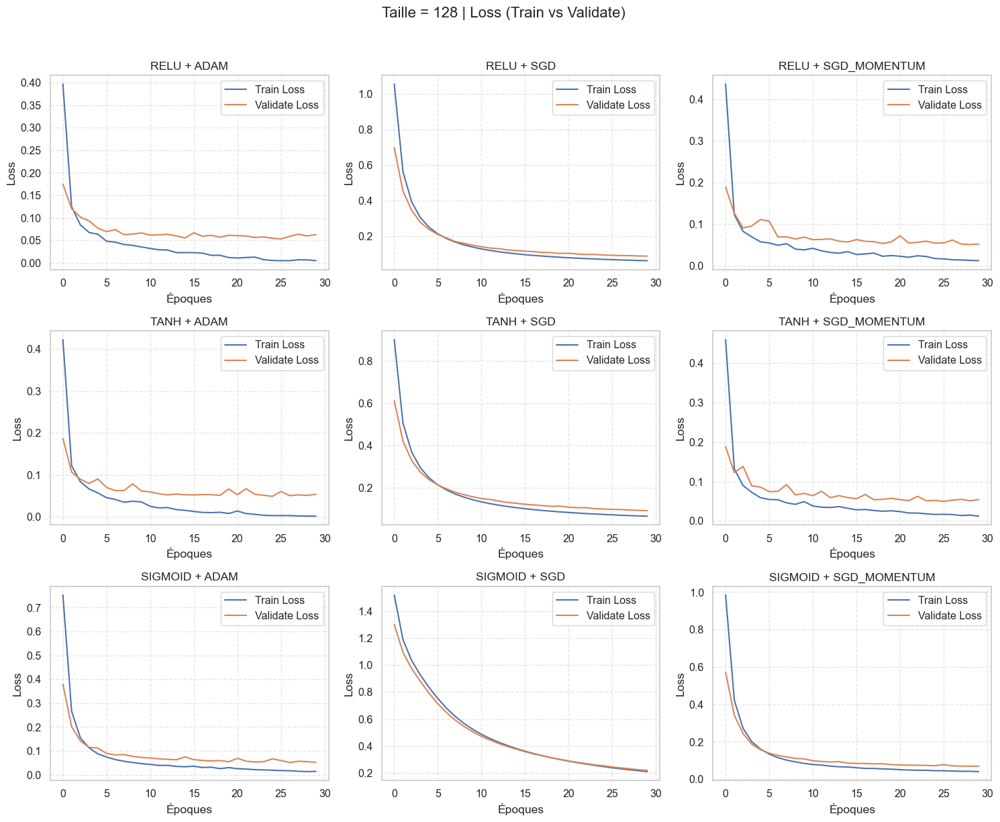

In [95]:
plot_experiment_grid(experiments, hidden_size=128, metric="loss")

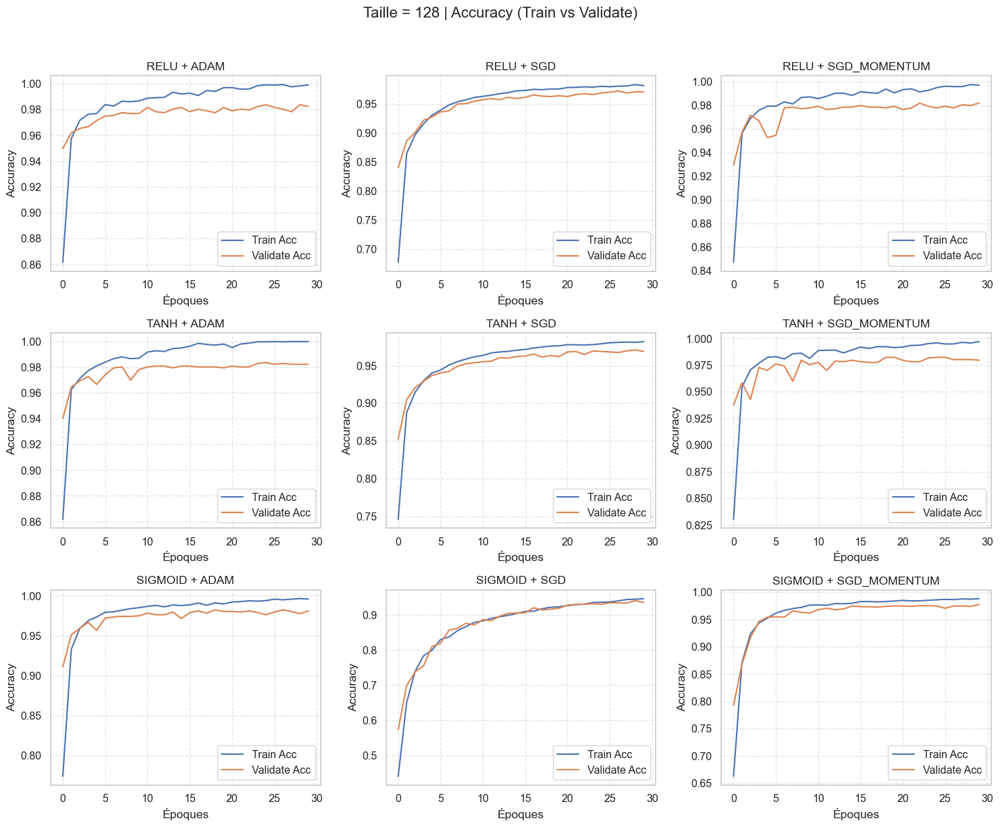

In [96]:
plot_experiment_grid(experiments, hidden_size=128, metric="accuracy")

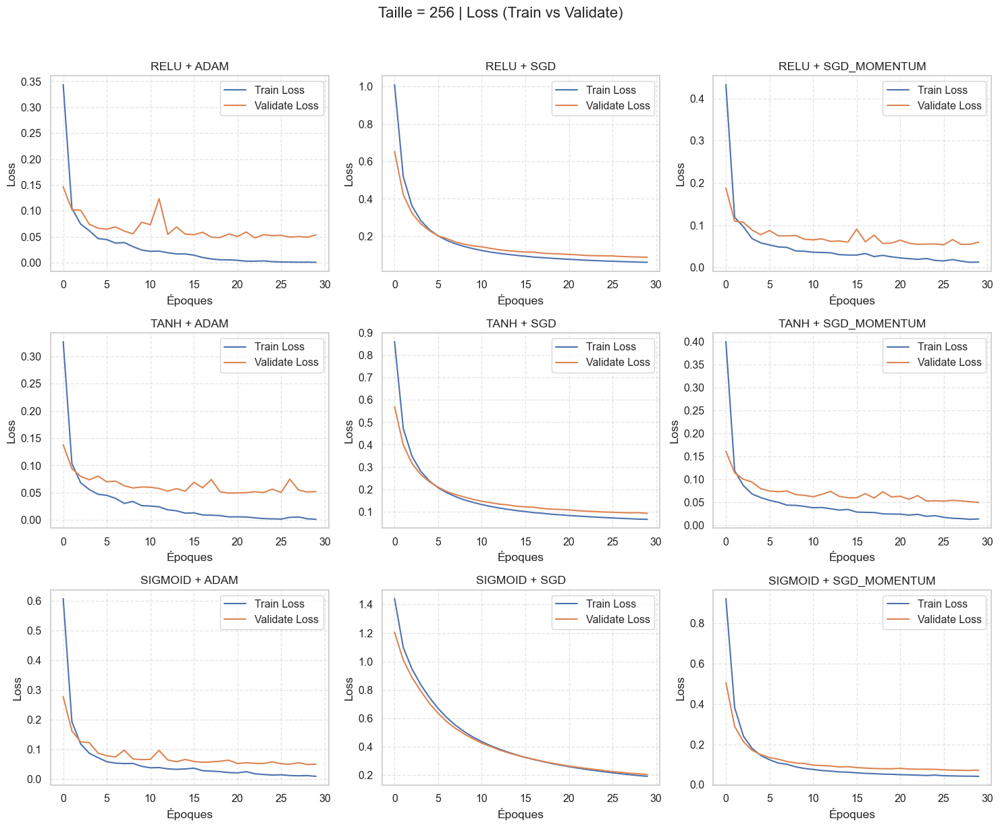

In [97]:
plot_experiment_grid(experiments, hidden_size=256, metric="loss")

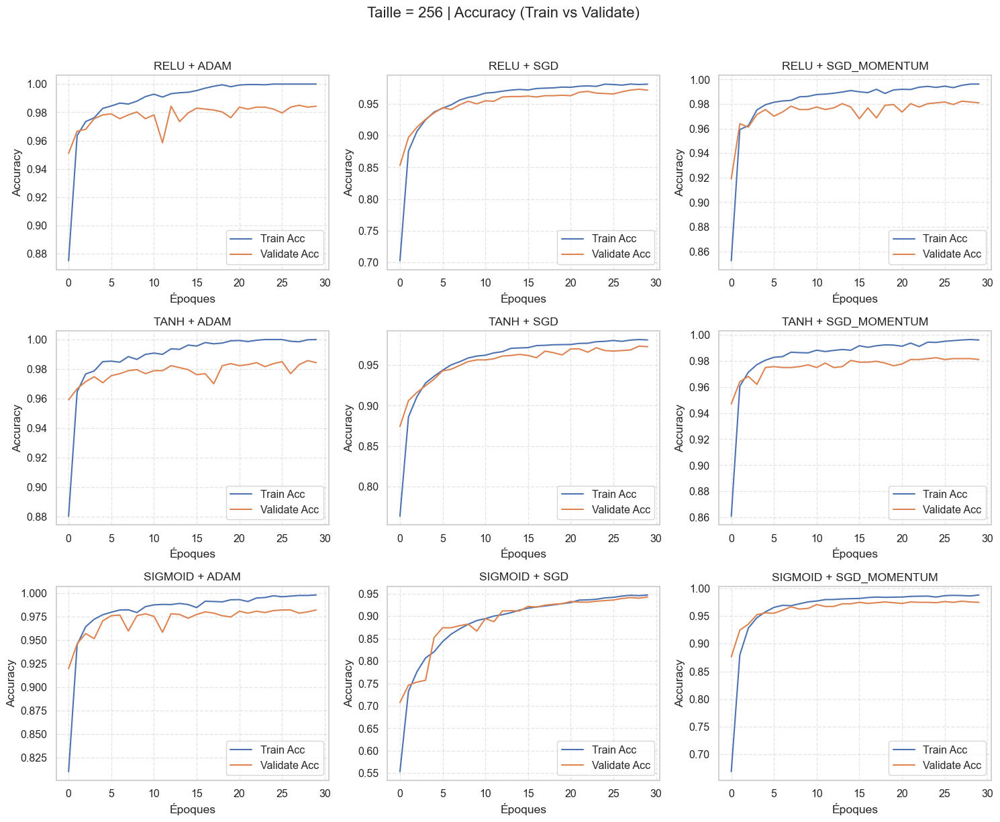

In [98]:
plot_experiment_grid(experiments, hidden_size=256, metric="accuracy")

L’étude des courbes d’accuracy et de loss pour les différentes combinaisons de fonctions d’activation et d’optimiseurs met en évidence plusieurs niveaux de surapprentissage. Globalement, tous les modèles atteignent une précision d’entraînement très élevée (souvent proche de 100 %), mais la précision sur le jeu de validation se stabilise à un niveau inférieur, indiquant une mauvaise généralisation. Cette tendance devient plus marquée lorsque la taille de la couche cachée augmente (de 64 à 128 neurones), car le réseau dispose alors d’une capacité d’apprentissage plus importante.

    ReLU + Adam

Ce couple affiche une forte convergence : l’accuracy d’entraînement atteint rapidement 1.0 alors que celle de la validation reste autour de 0.94–0.95. L’écart entre les deux courbes reste stable mais important, ce qui traduit un surapprentissage assez marqué. Le réseau apprend parfaitement les données d’entraînement, mais perd en capacité de généralisation. Ce phénomène est encore plus visible avec 128 neurones cachés, où la performance de test n’augmente plus malgré la poursuite de l’entraînement.

    ReLU + SGD

Dans ce cas, la convergence est plus lente et la précision d’entraînement reste légèrement inférieure à 1.0. La courbe de validation suit une tendance parallèle à celle de l’entraînement, avec un écart modéré et stable. On observe donc un surapprentissage léger, mais la généralisation reste correcte. Ce comportement montre que le SGD, bien que moins rapide, favorise une meilleure stabilité et un moindre surapprentissage.

    ReLU + SGD Momentum

Cette combinaison montre un comportement proche de ReLU + Adam : convergence rapide, accuracy train proche de 1.0 et validation autour de 0.95. L’écart constant entre les deux courbes révèle un surapprentissage marqué, similaire à celui observé avec Adam. Le modèle apprend vite et efficacement, mais conserve une différence significative entre les performances d’entraînement et de validation.

    Tanh + Adam

Le modèle converge rapidement avec une accuracy d’entraînement avoisinant 0.99 et une accuracy de validation autour de 0.94. Les deux courbes restent parallèles, avec un écart constant. Il y a donc un surapprentissage modéré, mais la généralisation demeure satisfaisante. Tanh produit ici des résultats plus lissés que ReLU, avec une stabilité appréciable.

    Tanh + SGD

Ici, la montée en performance est plus progressive. L’écart entre les courbes train et validate est relativement faible, et les deux se stabilisent vers 0.97 et 0.93 respectivement. Ce cas illustre un surapprentissage presque inexistant. Le modèle généralise bien.

    Tanh + SGD Momentum

La convergence est rapide, et la précision d’entraînement atteint presque 1.0 dès les premières époques. La précision de validation plafonne autour de 0.94, créant un surapprentissage assez marqué.

    Sigmoid + Adam

Le modèle apprend correctement, avec une précision d’entraînement proche de 0.99 et une précision de validation d’environ 0.94. Les courbes sont nettement séparées, traduisant un surapprentissage modéré.

    Sigmoid + SGD

Ce cas est particulier : la convergence est lente, la précision d’entraînement plafonne autour de 0.90 et la précision de validation autour de 0.85–0.90. Le modèle n’atteint pas une performance élevée comme les autres mais ne montre pas de véritable écart entre train et test. Ici, on a pas surapprentissage ni de sous-apprentissage.

    Sigmoid + SGD Momentum

Avec le SGD momentum, les performances s’améliorent nettement. L’accuracy d’entraînement atteint presque 0.98, tandis que celle de la validation se stabilise entre 0.95-0.98. L'écart entre les deux courbes reste très minime ainsi on ne peut pas parler de surapprentissage. La stabilité des courbes suggère un bon équilibre entre vitesse de convergence et capacité de généralisation.

En résumé, les combinaisons impliquant ReLU ou Tanh présentent un surapprentissage modéré à partir de la 5ᵉ–10ᵉ époque, surtout lorsqu’elles sont associées à Adam ou SGD Momentum. Les versions utilisant Sigmoid affichent une convergence plus lente. Enfin, l’augmentation de la taille de la couche cachée (de 64 à 128 neurones) accentue systématiquement le surapprentissage, car le réseau devient plus complexe et mémorise davantage les données d’entraînement. Pour limiter ce phénomène, l’introduction de techniques de régularisation (Dropout, Weight Decay, Early Stopping) serait pertinente afin d’améliorer la généralisation sans dégrader la performance d’apprentissage.


## Augmentation de la profondeur des réseaux

In [13]:
class MLP_FlexLayers(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim, 
                 n_hidden_layers=2, activation="relu"):
        super(MLP_FlexLayers, self).__init__()
        
        # Choix de l’activation
        if activation == "relu":
            self.activation = nn.ReLU()
        elif activation == "sigmoid":
            self.activation = nn.Sigmoid()
        elif activation == "tanh":
            self.activation = nn.Tanh()
        else:
            raise ValueError("Activation invalide")
        
        # Première couche
        self.layers = nn.ModuleList()
        self.layers.append(nn.Linear(input_dim, hidden_dim))
        
        # Couches cachées 
        for _ in range(n_hidden_layers-1):
            self.layers.append(nn.Linear(hidden_dim, hidden_dim))
        
        # Couche de sortie
        self.out = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        for layer in self.layers:
            x = layer(x)
            x = self.activation(x)
        
        x = self.out(x)
        return x

In [14]:
# Initialisation du modèle, de la loss et de l’optimiseur

input_dim = X_train_tensor.shape[1]
hidden_dim = 64
output_dim = len(label_encoder.classes_)

# Exemple avec ReLU et Adam
model = MLP_FlexLayers(input_dim, hidden_dim, output_dim, n_hidden_layers=2, activation="relu")

criterion = nn.CrossEntropyLoss()

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

print(model)

MLP_FlexLayers(
  (activation): ReLU()
  (layers): ModuleList(
    (0): Linear(in_features=561, out_features=64, bias=True)
    (1): Linear(in_features=64, out_features=64, bias=True)
  )
  (out): Linear(in_features=64, out_features=6, bias=True)
)


In [15]:
# Fonction d’entraînement et d’évaluation

def train_model(model, criterion, optimizer, train_loader, test_loader, epochs=30, device='cpu'):
    model.to(device)
    history = {"train_loss": [], "test_loss": [], "train_acc": [], "test_acc": [], "f1_macro": []}
    
    for epoch in range(epochs):
        # Entraînement 
        model.train()
        running_loss, running_correct = 0.0, 0
        
        for X_batch, y_batch in train_loader:
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
            
            optimizer.zero_grad()
            outputs = model(X_batch)
            loss = criterion(outputs, y_batch)
            loss.backward()
            optimizer.step()
            
            running_loss += loss.item() * X_batch.size(0)
            preds = outputs.argmax(1)
            running_correct += (preds == y_batch).sum().item()
        
        train_loss = running_loss / len(train_loader.dataset)
        train_acc = running_correct / len(train_loader.dataset)
        
        # Evaluation 
        model.eval()
        test_loss, test_correct = 0.0, 0
        y_true, y_pred = [], []
        
        with torch.no_grad():
            for X_batch, y_batch in test_loader:
                X_batch, y_batch = X_batch.to(device), y_batch.to(device)
                outputs = model(X_batch)
                loss = criterion(outputs, y_batch)
                test_loss += loss.item() * X_batch.size(0)
                preds = outputs.argmax(1)
                test_correct += (preds == y_batch).sum().item()
                y_true.extend(y_batch.cpu().numpy())
                y_pred.extend(preds.cpu().numpy())
        
        test_loss /= len(test_loader.dataset)
        test_acc = test_correct / len(test_loader.dataset)
        f1_macro = f1_score(y_true, y_pred, average='macro')
        
        # Sauvegarde
        history["train_loss"].append(train_loss)
        history["test_loss"].append(test_loss)
        history["train_acc"].append(train_acc)
        history["test_acc"].append(test_acc)
        history["f1_macro"].append(f1_macro)
        
        print(f"Epoch [{epoch+1}/{epochs}]  "
              f"Train Loss: {train_loss:.4f}  Test Loss: {test_loss:.4f}  "
              f"Train Acc: {train_acc:.4f}  Test Acc: {test_acc:.4f}  F1: {f1_macro:.4f}")
    
    return history

In [16]:
# Expérimentations : taille × activation × optimiseur × nb de couches

hidden_sizes = [64, 128, 256]
activations = ["relu", "tanh", "sigmoid"]
optimizers = ["adam", "sgd", "sgd_momentum"]
num_layers_list = [2, 3]

experiments = {}
summary_rows = []

for h in hidden_sizes:
    for act in activations:
        for opt_name in optimizers:
            for nl in num_layers_list:
                
                print("="*100)
                print(f"Expérience : hidden={h}, layers={nl}, activation={act}, optimiseur={opt_name}")
                
                # Modèle
                model = MLP_FlexLayers(
                    input_dim=input_dim,
                    hidden_dim=h,
                    output_dim=output_dim,
                    n_hidden_layers=nl,
                    activation=act
                )
                
                # Optimiseur
                if opt_name == "adam":
                    optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
                elif opt_name == "sgd":
                    optimizer = torch.optim.SGD(model.parameters(), lr=1e-2)
                elif opt_name == "sgd_momentum":
                    optimizer = torch.optim.SGD(model.parameters(), lr=1e-2, momentum=0.9)
                
                # Entraînement
                history = train_model(model, criterion, optimizer, train_loader, valid_loader,  epochs=30, device=device)
                
                # Sauvegarde
                experiments[(h, nl, act, opt_name)] = history
                
                best_epoch = np.argmax(history["test_acc"])
                summary_rows.append({
                    "Hidden": h,
                    "Layers": nl,
                    "Activation": act,
                    "Optimiseur": opt_name,
                    "Epoch*": best_epoch+1,
                    "Train Acc": history["train_acc"][best_epoch],
                    "Test Acc": history["test_acc"][best_epoch],
                    "F1 Macro": history["f1_macro"][best_epoch],
                    "Test Loss": history["test_loss"][best_epoch]
                })

Expérience : hidden=64, layers=2, activation=relu, optimiseur=adam
Epoch [1/30]  Train Loss: 0.5729  Test Loss: 0.2156  Train Acc: 0.7844  Test Acc: 0.9137  F1: 0.9173
Epoch [2/30]  Train Loss: 0.1450  Test Loss: 0.1254  Train Acc: 0.9469  Test Acc: 0.9613  F1: 0.9633
Epoch [3/30]  Train Loss: 0.0875  Test Loss: 0.0945  Train Acc: 0.9672  Test Acc: 0.9646  F1: 0.9660
Epoch [4/30]  Train Loss: 0.0723  Test Loss: 0.0882  Train Acc: 0.9736  Test Acc: 0.9680  F1: 0.9694
Epoch [5/30]  Train Loss: 0.0631  Test Loss: 0.0752  Train Acc: 0.9787  Test Acc: 0.9742  F1: 0.9754
Epoch [6/30]  Train Loss: 0.0542  Test Loss: 0.0806  Train Acc: 0.9784  Test Acc: 0.9721  F1: 0.9735
Epoch [7/30]  Train Loss: 0.0495  Test Loss: 0.0651  Train Acc: 0.9815  Test Acc: 0.9762  F1: 0.9770
Epoch [8/30]  Train Loss: 0.0441  Test Loss: 0.0700  Train Acc: 0.9847  Test Acc: 0.9735  F1: 0.9747
Epoch [9/30]  Train Loss: 0.0404  Test Loss: 0.0872  Train Acc: 0.9838  Test Acc: 0.9606  F1: 0.9627
Epoch [10/30]  Train Los

In [17]:
df_exp_summary = pd.DataFrame(summary_rows)
df_exp_summary = df_exp_summary.sort_values(by="Test Acc", ascending=False)
display(df_exp_summary.head(10))

,Hidden,Layers,Activation,Optimiseur,Epoch*,Train Acc,Test Acc,F1 Macro,Test Loss
42,256,2,tanh,adam,22,1.000000,0.989803,0.990368,0.051324
6,64,2,tanh,adam,29,1.000000,0.987763,0.988047,0.055918
37,256,3,relu,adam,22,0.998980,0.987084,0.987354,0.065959
7,64,3,tanh,adam,23,1.000000,0.987084,0.987359,0.062994
1,64,3,relu,adam,28,0.997960,0.986404,0.986658,0.059152
43,256,3,tanh,adam,23,0.998130,0.986404,0.986808,0.064520
36,256,2,relu,adam,12,0.995409,0.985724,0.986030,0.049911
41,256,3,relu,sgd_momentum,22,0.999320,0.985724,0.986172,0.057117
24,128,2,tanh,adam,27,1.000000,0.985044,0.985355,0.065504
0,64,2,relu,adam,14,0.989798,0.984364,0.984942,0.054677


In [18]:
# Visualisation des courbes train/validation

def plot_experiment_grid(results_dict, hidden_sizes, n_layers_list, metric="loss"):
    for hidden_size in hidden_sizes:
        for n_layers in n_layers_list:
            activations = sorted({k[2] for k in results_dict.keys() if k[0] == hidden_size and k[1] == n_layers})
            optimizers = sorted({k[3] for k in results_dict.keys() if k[0] == hidden_size and k[1] == n_layers})
            
            n_rows = len(activations)
            n_cols = len(optimizers)
            fig, axes = plt.subplots(n_rows, n_cols, figsize=(5*n_cols, 4*n_rows))
            
            if n_rows == 1 and n_cols == 1:
                axes = [[axes]]
            elif n_rows == 1:
                axes = [axes]
            
            for i, act in enumerate(activations):
                for j, opt in enumerate(optimizers):
                    ax = axes[i][j] if n_rows > 1 else axes[0][j]
                    hist = results_dict[(hidden_size, n_layers, act, opt)]
                    
                    if metric == "loss":
                        ax.plot(hist["train_loss"], label="Train Loss")
                        ax.plot(hist["test_loss"], label="Validate Loss")
                        ax.set_ylabel("Loss")
                    elif metric == "accuracy":
                        ax.plot(hist["train_acc"], label="Train Acc")
                        ax.plot(hist["test_acc"], label="Validate Acc")
                        ax.set_ylabel("Accuracy")
                    
                    ax.set_title(f"{act.upper()} + {opt.upper()}")
                    ax.set_xlabel("Époques")
                    ax.legend()
                    ax.grid(True, linestyle="--", alpha=0.5)
            
            plt.suptitle(f"Hidden={hidden_size} | Layers={n_layers} | {metric.capitalize()} (Train vs Validate)",
                         fontsize=16, y=1.02)
            plt.tight_layout()
            plt.show()

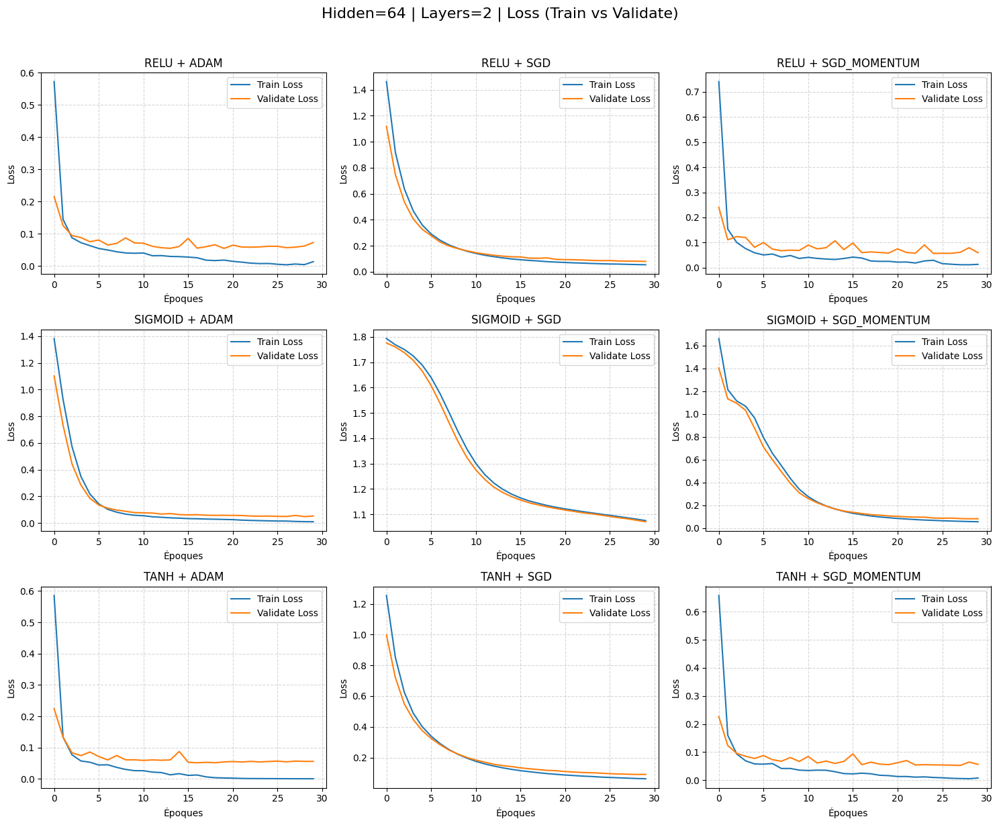

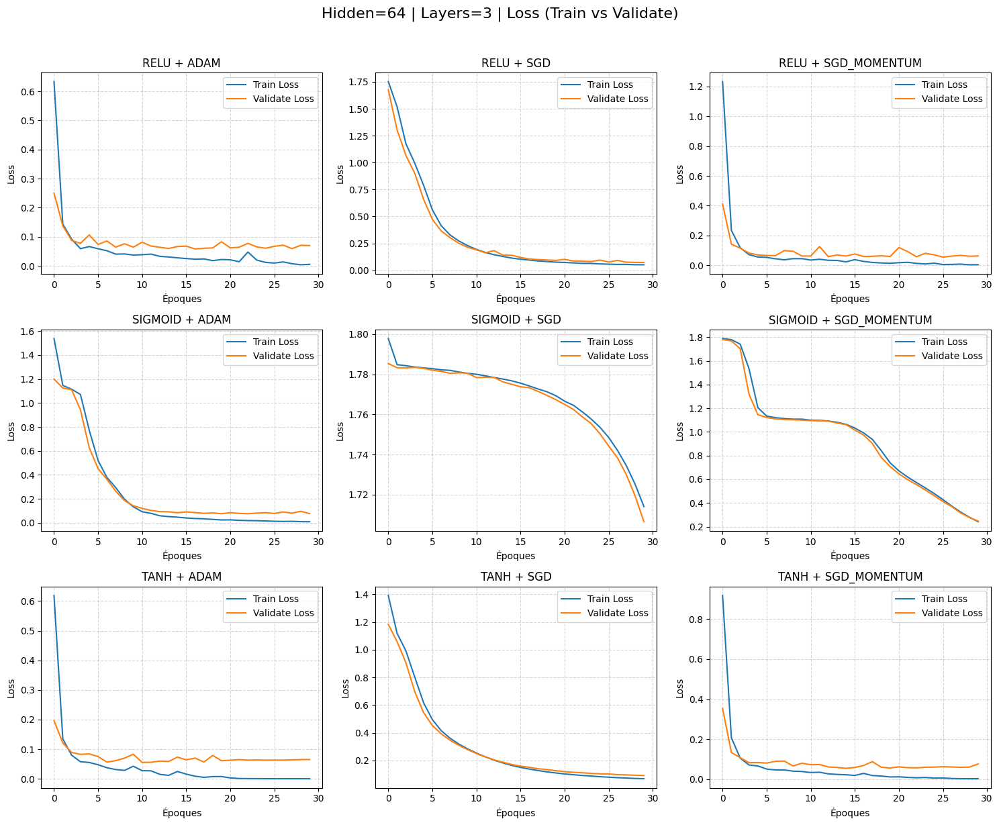

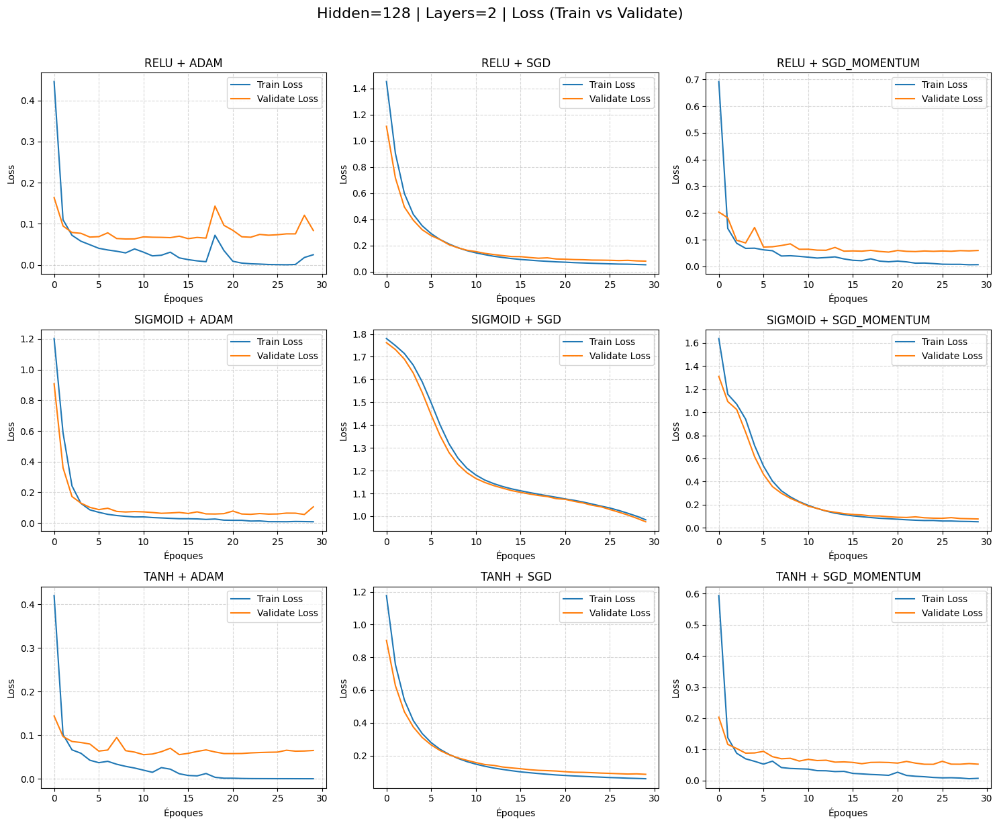

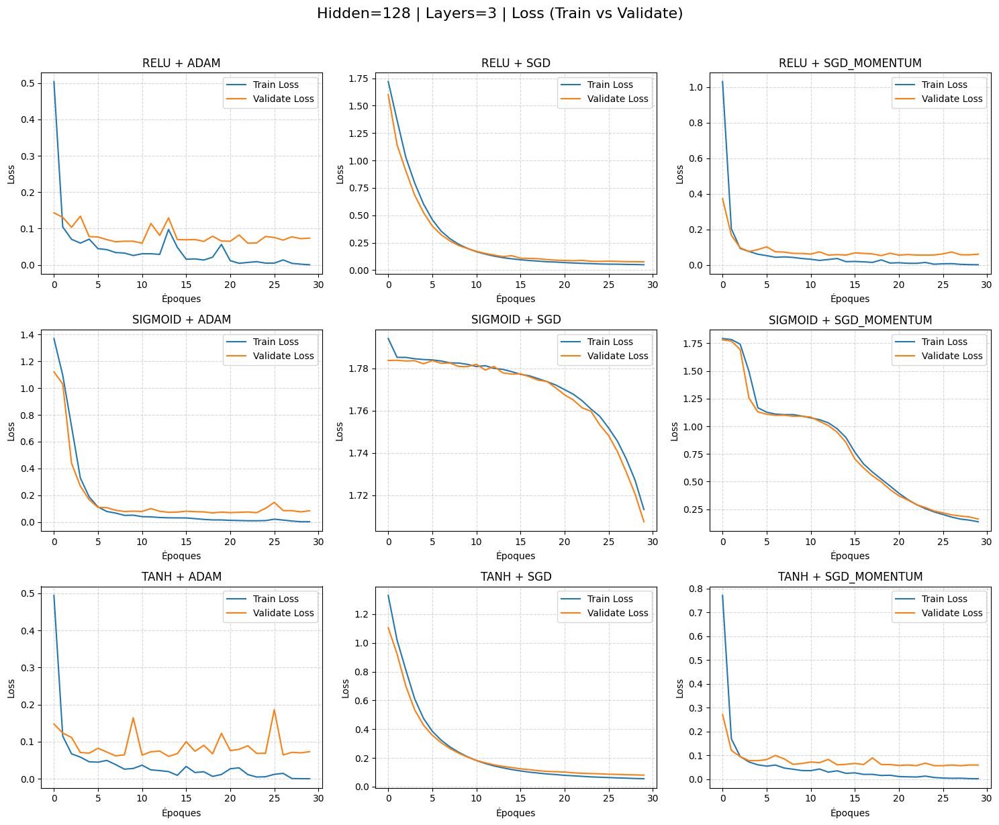

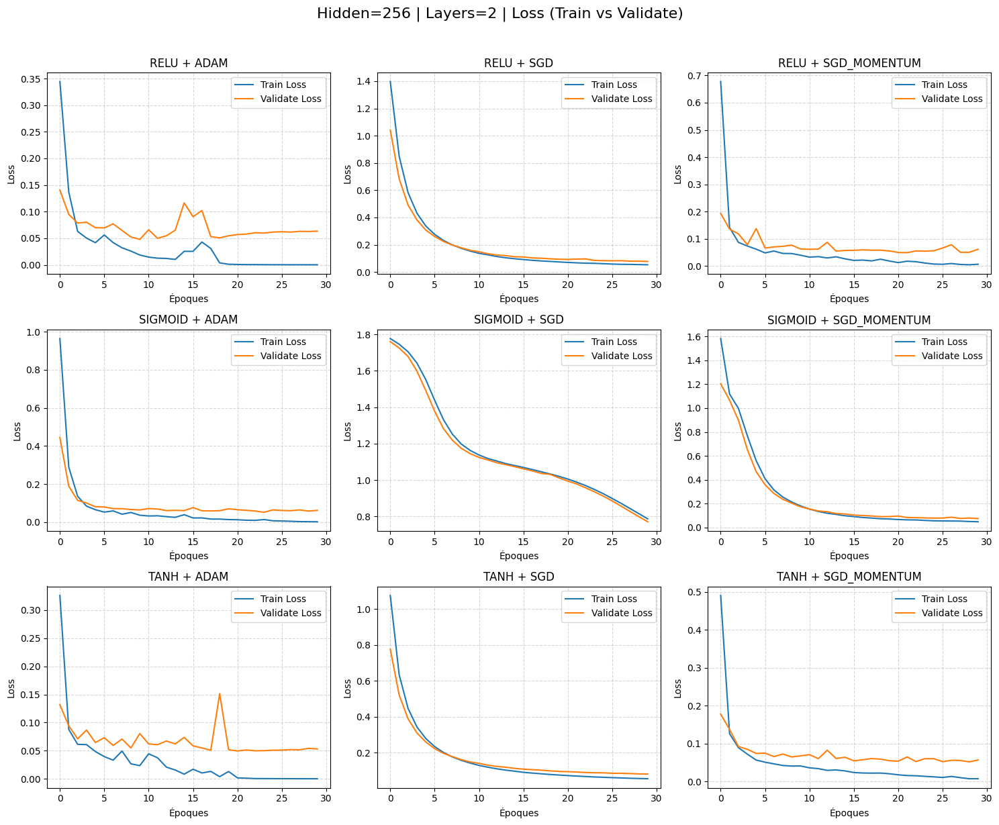

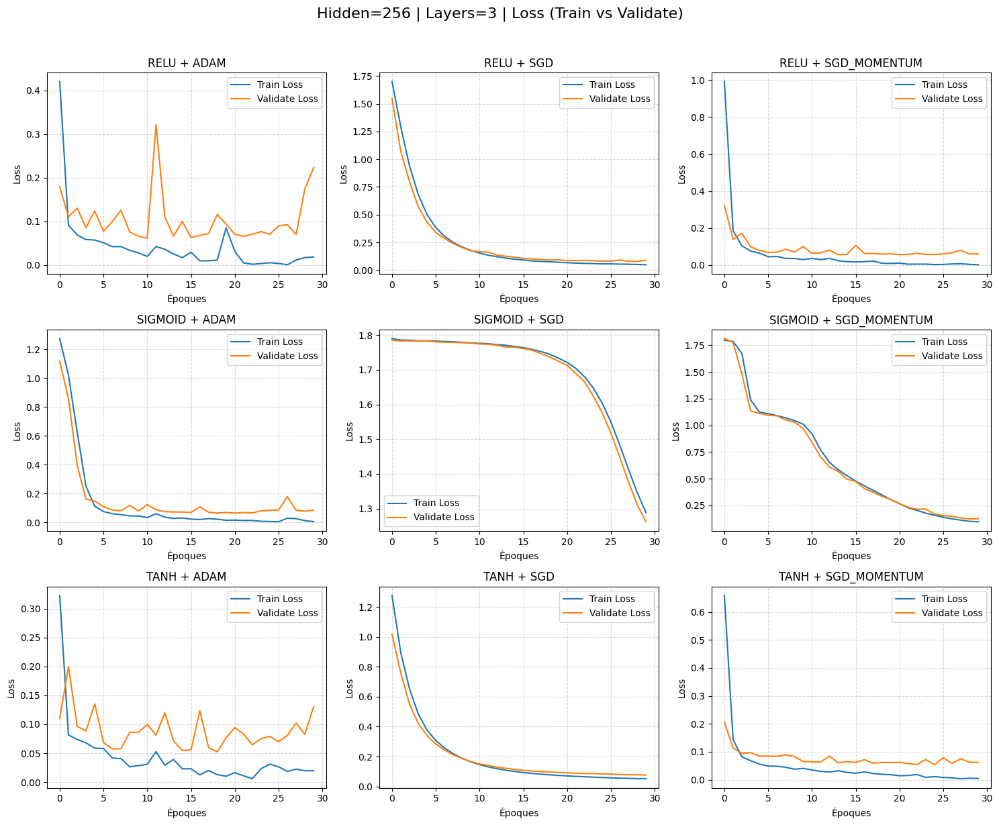

In [24]:
plot_experiment_grid(experiments, hidden_sizes=hidden_sizes, n_layers_list=num_layers_list, metric="loss")

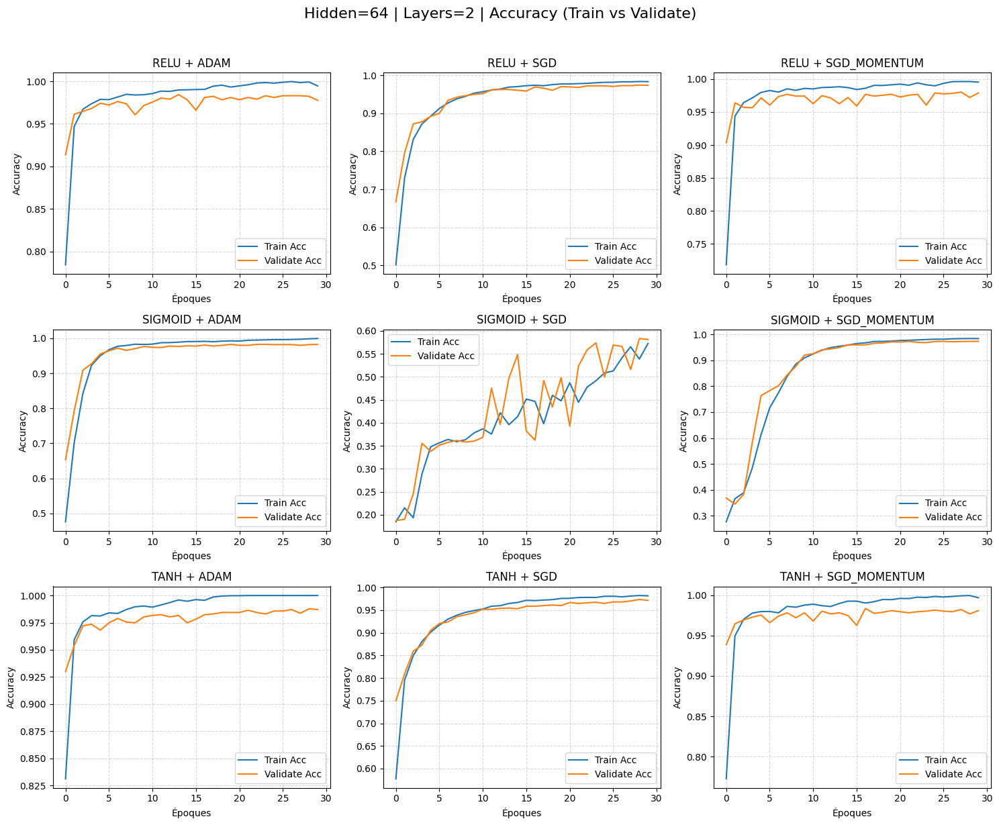

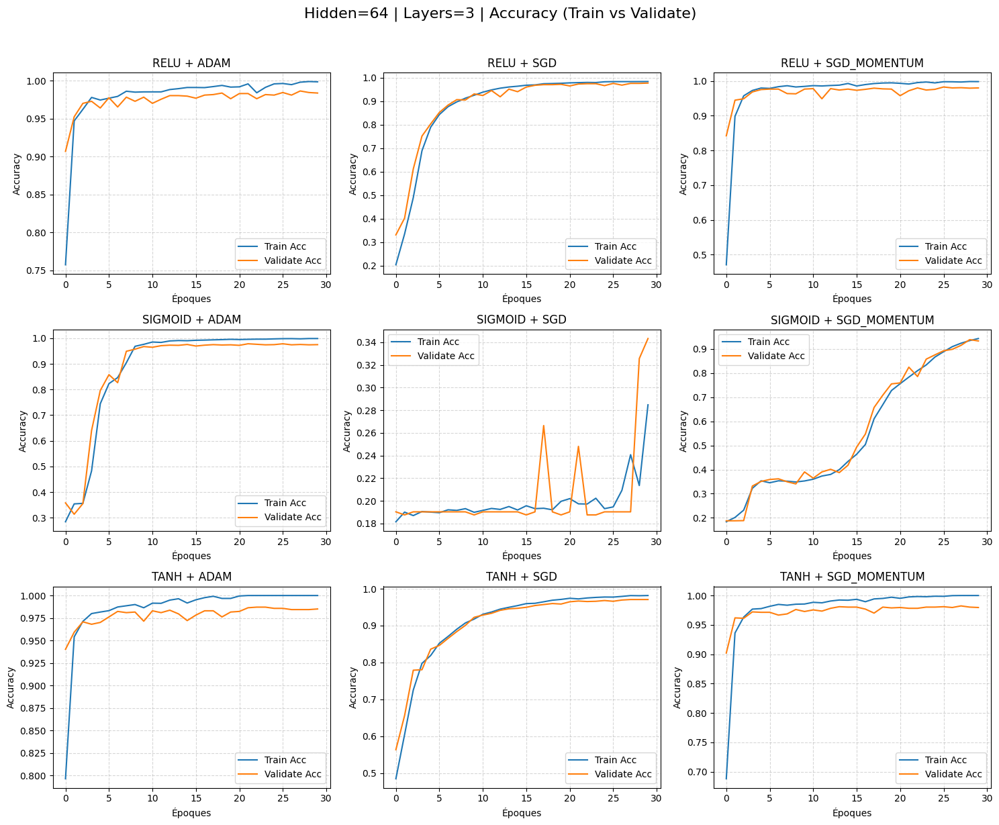

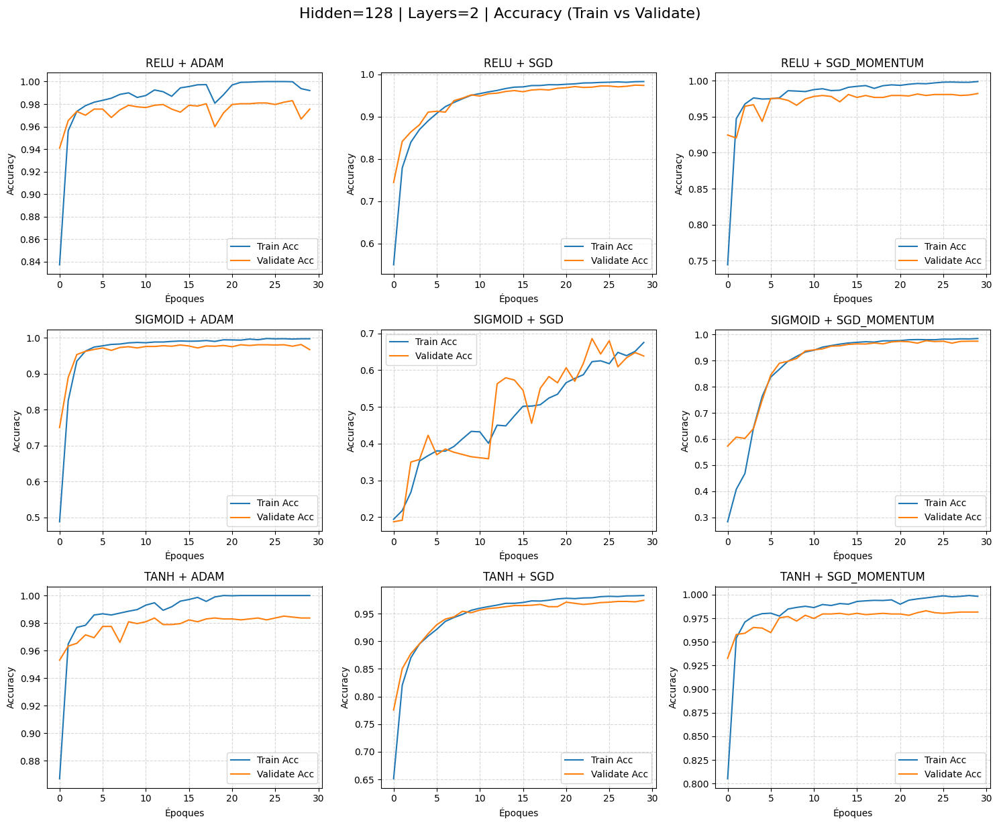

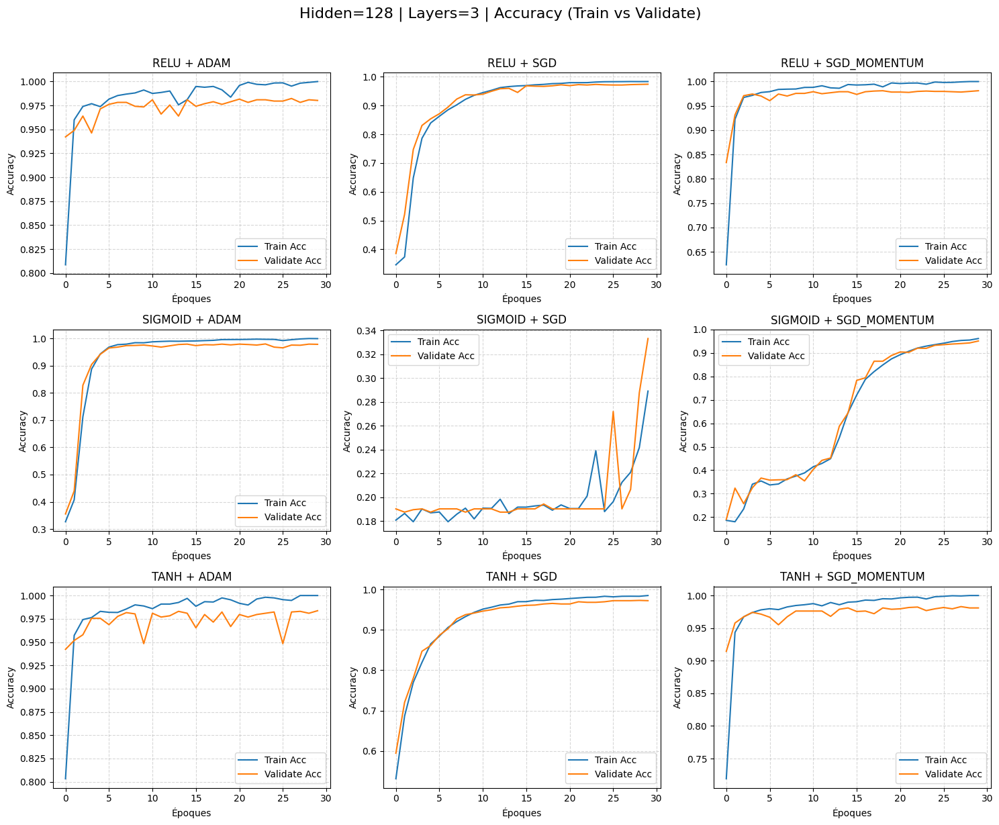

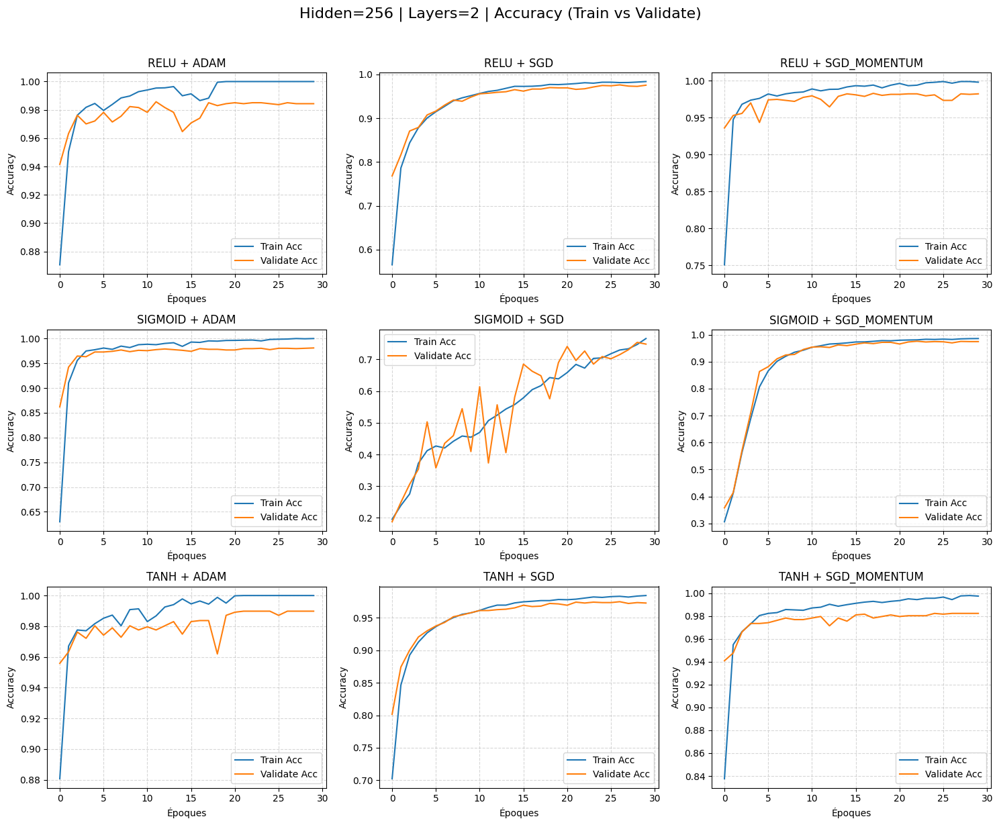

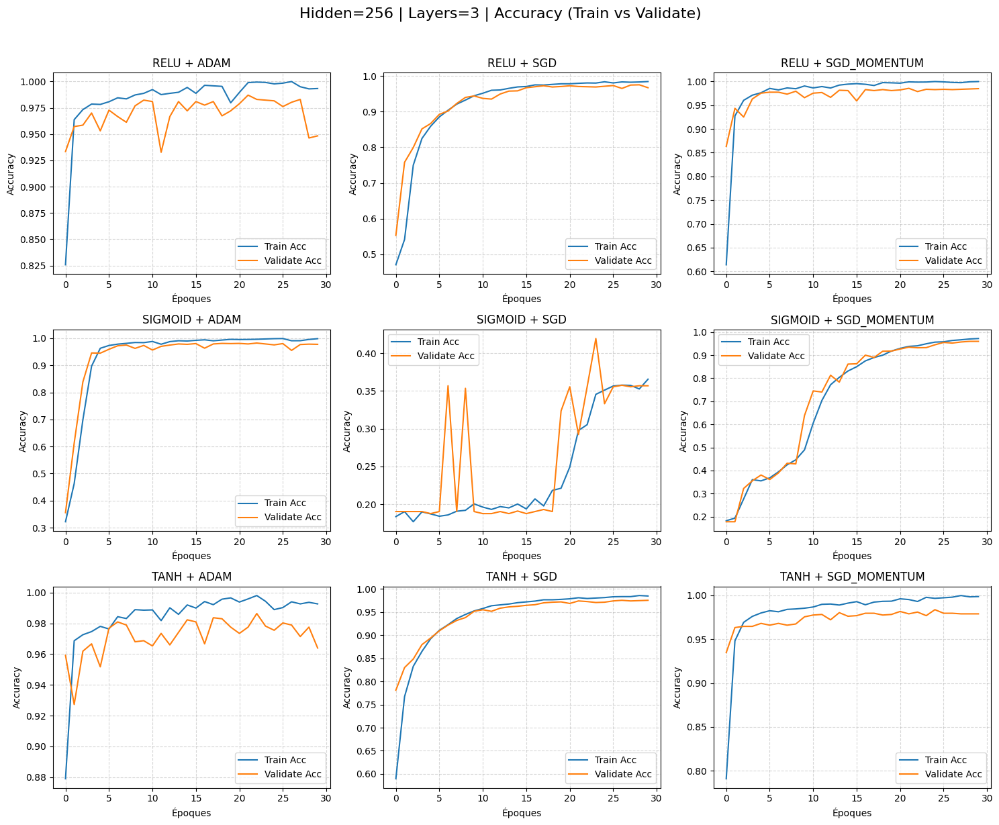

In [25]:
plot_experiment_grid(experiments, hidden_sizes=hidden_sizes, n_layers_list=num_layers_list, metric="accuracy")

L’étude des courbes d’accuracy et de loss pour les différentes combinaisons de fonctions d’activation et d’optimiseurs met en évidence plusieurs niveaux de surapprentissage. Globalement, tous les modèles atteignent une précision d’entraînement très élevée (souvent proche de 100 %), mais la précision sur le jeu de validation se stabilise à un niveau inférieur, indiquant une mauvaise généralisation. Cette tendance devient plus marquée lorsque la taille de la couche cachée augmente (de 64 à 128 neurones), car le réseau dispose alors d’une capacité d’apprentissage plus importante.

- ReLU + Adam

Ce couple affiche une forte convergence : l’accuracy d’entraînement atteint 1.0 dès les premières époques, tandis que la validation reste autour de 0.94–0.95. L’écart reste stable mais important, traduisant un surapprentissage marqué. Ce phénomène s’accentue avec l’augmentation de la profondeur (3 couches) et de la taille (128 ou 256 neurones), où la performance de validation n’évolue plus malgré la poursuite de l’entraînement.

- ReLU + SGD

Dans ce cas, la convergence est plus lente et la précision d’entraînement reste légèrement inférieure à 1.0 mais la courbe de validation suit celle de l’entraînement avec un écart faible. Même avec 3 couches et 256 neurones, le surapprentissage reste limité la généralisation est correcte. Ce comportement montre que le SGD, bien que moins rapide, favorise une meilleure stabilité et un moindre surapprentissage.

- ReLU + SGD Momentum

Cette combinaison montre un comportement proche de ReLU + Adam : convergence rapide, accuracy train proche de 1.0 et validation autour de 0.95. L’écart constant entre les deux courbes révèle un surapprentissage marqué, surtout avec des architectures profondes. Le modèle apprend vite et efficacement, mais conserve une différence significative entre les performances d’entraînement et de validation.

- Tanh + Adam

Le modèle converge rapidement avec une accuracy d’entraînement avoisinant 0.99 et une accuracy de validation autour de 0.94. Les deux courbes restent parallèles, avec un écart constant. Il y a donc un surapprentissage modéré, mais qui augmente avec la profondeur et la taille des couches.

- Tanh + SGD

Ici, la montée en performance est plus progressive. L’écart entre les courbes train et validate est relativement faible, et les deux se stabilisent vers 0.97 respectivement. Ce cas illustre un surapprentissage presque inexistant. Le modèle généralise bien même avec 128 neurones et 3 couches.


- Tanh + SGD Momentum

La convergence est rapide, et la précision d’entraînement atteint presque 1.0 dès les premières époques. La précision de validation plafonne autour de 0.97, créant un surapprentissage assez marqué accentué avec 3 couches

- Sigmoid + Adam

Le modèle apprend correctement, avec une précision d’entraînement proche de 0.98 et une précision de validation d’environ 0.93. Les courbes sont nettement séparées, traduisant un surapprentissage modéré.

- Sigmoid + SGD

Ce cas est particulier, on assiste à un comportement très instable avec des oscillations importantes. La convergence est lente, la précision d’entraînement plafonne autour de 0.90 et la précision de validation autour de 0.85–0.90. Le modèle n’atteint pas une performance élevée comme les autres. Ici, on a pas de surapprentissage mais possiblement du sous-apprentissage.

- Sigmoid + SGD Momentum

Avec le SGD momentum, les performances s’améliorent nettement. L’accuracy d’entraînement atteint presque 0.98, tandis que celle de la validation se stabilise entre 0.95. L'écart entre les deux courbes reste très minime ainsi on ne peut pas parler de surapprentissage. La stabilité des courbes suggère un bon équilibre entre vitesse de convergence et capacité de généralisation.


En résumé :
- Surapprentissage très marqué avec ReLU/Tanh + Adam ou SGD Momentum, surtout avec 3 couches et ≥ 128 neurones.
- Surapprentissage modéré avec Tanh + Adam et Tanh + SGD Momentum.
- Surapprentissage quasi absent avec SGD simple et Sigmoid + SGD Momentum.
- Sigmoid + SGD reste instable et peu performant.
 
Plus la profondeur et la taille augmentent, plus le surapprentissage s’accentue.

## Partie 4 : Régularisation et robustesse

In [26]:
# Le modèle MLP_FlexLayers avec Dropout et BatchNorm
class MLP_FlexLayers_Reg(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim, n_hidden_layers=2, activation="relu", dropout_rate=0.0, batch_norm=False):
        super().__init__()
        
        # Choix de l'activation
        if activation == "relu":
            self.activation = nn.ReLU()
        elif activation == "sigmoid":
            self.activation = nn.Sigmoid()
        elif activation == "tanh":
            self.activation = nn.Tanh()
        else:
            raise ValueError("Activation invalide")
        
        layers = []
        # Première couche
        layers.append(nn.Linear(input_dim, hidden_dim))
        if batch_norm: layers.append(nn.BatchNorm1d(hidden_dim))
        if dropout_rate > 0: layers.append(nn.Dropout(dropout_rate))
        
        # Couches cachées 
        for _ in range(n_hidden_layers - 1):
            layers.append(nn.Linear(hidden_dim, hidden_dim))
            if batch_norm: layers.append(nn.BatchNorm1d(hidden_dim))
            if dropout_rate > 0: layers.append(nn.Dropout(dropout_rate))
        
        self.hidden_layers = nn.ModuleList(layers)
        self.out = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        for layer in self.hidden_layers:
            if isinstance(layer, nn.Linear):
                x = layer(x)
                x = self.activation(x)
            else:
                x = layer(x)
        return self.out(x)

### Fonction d’entraînement avec Early Stopping

In [27]:
def train_model_Reg(model, criterion, optimizer, train_loader, valid_loader, epochs=30, device='cpu', patience=5):
    model.to(device)
    history = {"train_loss": [], "test_loss": [], "train_acc": [], "test_acc": [], "f1_macro": []}
    
    best_val_loss = float('inf')
    patience_counter = 0
    best_state = None
    
    for epoch in range(epochs):
        # Entraînement
        model.train()
        running_loss, correct = 0.0, 0
        for Xb, yb in train_loader:
            Xb, yb = Xb.to(device), yb.to(device)
            optimizer.zero_grad()
            out = model(Xb)
            loss = criterion(out, yb)
            loss.backward()
            optimizer.step()
            running_loss += loss.item() * Xb.size(0)
            preds = out.argmax(1)
            correct += (preds == yb).sum().item()
        
        train_loss = running_loss / len(train_loader.dataset)
        train_acc = correct / len(train_loader.dataset)
        
        # Validation
        model.eval()
        val_loss, val_correct = 0.0, 0
        y_true, y_pred = [], []
        with torch.no_grad():
            for Xb, yb in valid_loader:
                Xb, yb = Xb.to(device), yb.to(device)
                out = model(Xb)
                loss = criterion(out, yb)
                val_loss += loss.item() * Xb.size(0)
                preds = out.argmax(1)
                val_correct += (preds == yb).sum().item()
                y_true.extend(yb.cpu().numpy())
                y_pred.extend(preds.cpu().numpy())
        
        val_loss /= len(valid_loader.dataset)
        val_acc = val_correct / len(valid_loader.dataset)
        f1_macro = f1_score(y_true, y_pred, average='macro')
        
        history["train_loss"].append(train_loss)
        history["test_loss"].append(val_loss)
        history["train_acc"].append(train_acc)
        history["test_acc"].append(val_acc)
        history["f1_macro"].append(f1_macro)
        
        print(f"Epoch [{epoch+1}/{epochs}] Train Loss: {train_loss:.4f} Test Loss: {val_loss:.4f} Train Acc: {train_acc:.4f} Test Acc: {val_acc:.4f} F1: {f1_macro:.4f}")
        
        # Early stopping
        if val_loss < best_val_loss - 1e-5:
            best_val_loss = val_loss
            best_state = model.state_dict().copy()
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"\nEarly stopping triggered at epoch {epoch+1}")
                break
    
    if best_state:
        model.load_state_dict(best_state)
    
    return history

### Pipeline pour la régularisation

In [29]:
# Configurations à tester
configs = [
    ("sigmoid", "sgd"), ("sigmoid", "sgd_momentum"),
    ("tanh", "sgd"), ("relu", "adam"), ("relu", "sgd_momentum"),
    ("tanh", "adam")
]

hidden_sizes = [64, 128, 256]
dropout_values = [0.1, 0.3, 0.5]
weight_decays = [1e-4, 1e-3]
n_layers_list = [2, 3]

results = {}

for activation, opt_type in configs:
    for hidden_dim in hidden_sizes:
        for n_layers in n_layers_list:
            for dropout in dropout_values:
                for wd in weight_decays:
                    print(f"\nConfig: act={activation}, opt={opt_type}, hidden={hidden_dim}, layers={n_layers}, dropout={dropout}, wd={wd}")
                    
                    model = MLP_FlexLayers_Reg(input_dim, hidden_dim, output_dim, n_hidden_layers=n_layers,
                                         activation=activation, dropout_rate=dropout, batch_norm=True)
                    
                    if opt_type == "adam":
                        optimizer = optim.Adam(model.parameters(), lr=1e-3, weight_decay=wd)
                    elif opt_type == "sgd":
                        optimizer = optim.SGD(model.parameters(), lr=1e-2, weight_decay=wd)
                    elif opt_type == "sgd_momentum":
                        optimizer = optim.SGD(model.parameters(), lr=1e-2, momentum=0.9, weight_decay=wd)
                    
                    hist = train_model_Reg(model, criterion, optimizer, train_loader, valid_loader, epochs=30, device=device)
                    results[(activation, opt_type, hidden_dim, n_layers, dropout, wd)] = hist


Config: act=sigmoid, opt=sgd, hidden=64, layers=2, dropout=0.1, wd=0.0001
Epoch [1/30] Train Loss: 0.6077 Test Loss: 0.3340 Train Acc: 0.8230 Test Acc: 0.9191 F1: 0.9183
Epoch [2/30] Train Loss: 0.2849 Test Loss: 0.2204 Train Acc: 0.9298 Test Acc: 0.9490 F1: 0.9499
Epoch [3/30] Train Loss: 0.2001 Test Loss: 0.1805 Train Acc: 0.9497 Test Acc: 0.9477 F1: 0.9492
Epoch [4/30] Train Loss: 0.1622 Test Loss: 0.1391 Train Acc: 0.9575 Test Acc: 0.9592 F1: 0.9605
Epoch [5/30] Train Loss: 0.1391 Test Loss: 0.1282 Train Acc: 0.9623 Test Acc: 0.9674 F1: 0.9682
Epoch [6/30] Train Loss: 0.1155 Test Loss: 0.1157 Train Acc: 0.9714 Test Acc: 0.9687 F1: 0.9696
Epoch [7/30] Train Loss: 0.1053 Test Loss: 0.1014 Train Acc: 0.9719 Test Acc: 0.9735 F1: 0.9743
Epoch [8/30] Train Loss: 0.0953 Test Loss: 0.0941 Train Acc: 0.9755 Test Acc: 0.9762 F1: 0.9772
Epoch [9/30] Train Loss: 0.0876 Test Loss: 0.1015 Train Acc: 0.9769 Test Acc: 0.9646 F1: 0.9666
Epoch [10/30] Train Loss: 0.0834 Test Loss: 0.1261 Train Acc:

###  Visualisation 

In [34]:
import math
def plot_results_grid(results, metric="accuracy", cols=2):
    
    keys = list(results.keys())
    n = len(keys)
    rows = math.ceil(n / cols)
    
    fig, axes = plt.subplots(rows, cols, figsize=(6*cols, 4*rows))
    axes = axes.flatten()
    
    for idx, key in enumerate(keys):
        act, opt, hidden, layers, dropout, wd = key
        hist = results[key]
        
        ax = axes[idx]
        if metric == "accuracy":
            ax.plot(hist["train_acc"], label="Train Acc")
            ax.plot(hist["test_acc"], label="Validate Acc")
            ax.set_ylabel("Accuracy")
        elif metric == "loss":
            ax.plot(hist["train_loss"], label="Train Loss")
            ax.plot(hist["test_loss"], label="Validate Loss")
            ax.set_ylabel("Loss")
        
        ax.set_title(f"{act.upper()} + {opt.upper()}\nH={hidden}, L={layers}, Drop={dropout}, WD={wd}")
        ax.set_xlabel("Epochs")
        ax.legend(fontsize=8)
        ax.grid(True, linestyle="--", alpha=0.5)
    
    for i in range(idx+1, len(axes)):
        fig.delaxes(axes[i])
    
    plt.tight_layout()
    plt.show()

In [35]:
# Accuracy 
plot_results_grid(results, metric="accuracy", cols=4)

In [36]:
# La loss 
plot_results_grid(results, metric="loss", cols=4)

### Réduction du sur-apprentissage

Avant régularisation : les courbes Train vs Validation divergeaient après 15–20 époques (surtout ReLU + Adam et Tanh + Adam).
Après la régularisation, les courbes sont beaucoup plus proches, surtout avec Dropout = 0.3 et Weight Decay = 1e-4 ou 1e-3.
BatchNorm semble avoir stabilisé les oscillations pour Tanh et Sigmoid.

### Stabilité des courbes

Les oscillations visibles dans Sigmoid + SGD Momentum et Tanh + SGD sont atténuées.
Early stopping a aussi limité ceratines fluctuations en fin d’entraînement.

### Impact sur configurations problématiques

- Sigmoid + SGD : reste faible (accuracy < 0.8), même avec régularisation.
- Tanh + SGD : nette amélioration, validation accuracy proche de 0.9 avec Dropout + WD.
- ReLU + Adam : bonne amélioration, l'écart entre train/validation réduit.
- ReLU + SGD Momentum : amélioration notable, mais moins rapide qu’Adam.
- Tanh + Adam : stabilisation, validation accuracy > 0.93 avec régularisation.


### Configurations optimales

- ReLU + Adam + Dropout(0.3) + WD(1e-4) : meilleure combinaison.
- Tanh + Adam + Dropout(0.3) : bon compromis pour robustesse.
- BatchNorm : bénéfique surtout pour Sigmoid et Tanh (réduit oscillations).
 
### Rémarque importante

- Sigmoid + SGD reste mauvais malgré la régularisation.
- Trop de Dropout (0.5) ralentit la convergence sans gain significatif.

### Conclusion 

Pour conclure, on peut bel et bien affirmer qu'il y a eu des améliorations significatives :
- Moins de sur-apprentissage.
- Courbes plus stables.
- Meilleure généralisation pour ReLU et Tanh avec Adam.
  
La régularisation a eu un impact positif, mais à mon avis ceratins choix d’activation/optimiseur peut être inadaptés selon le type de problème ou de jeu de données.

In [39]:
df_results = pd.DataFrame(results)
df_exp_summary = df_exp_summary.sort_values(by="Test Acc", ascending=False)

### Top 10 des meilleurs résultats

In [41]:
display(df_exp_summary.head(10))

,Hidden,Layers,Activation,Optimiseur,Epoch*,Train Acc,Test Acc,F1 Macro,Test Loss
42,256,2,tanh,adam,22,1.000000,0.989803,0.990368,0.051324
6,64,2,tanh,adam,29,1.000000,0.987763,0.988047,0.055918
37,256,3,relu,adam,22,0.998980,0.987084,0.987354,0.065959
7,64,3,tanh,adam,23,1.000000,0.987084,0.987359,0.062994
1,64,3,relu,adam,28,0.997960,0.986404,0.986658,0.059152
43,256,3,tanh,adam,23,0.998130,0.986404,0.986808,0.064520
36,256,2,relu,adam,12,0.995409,0.985724,0.986030,0.049911
41,256,3,relu,sgd_momentum,22,0.999320,0.985724,0.986172,0.057117
24,128,2,tanh,adam,27,1.000000,0.985044,0.985355,0.065504
0,64,2,relu,adam,14,0.989798,0.984364,0.984942,0.054677


On continue avec ces deux configurations :

- ReLU + SGD Momentum | Hidden = 128 | Layers = 2 | Dropout = 0.3 | Weight Decay = 0.0001

- Tanh + Adam | Hidden = 128 | Layers = 2 | Dropout = 0.3 | Weight Decay = 0.0001

## Partie 5 : Visualisation et analyse des performances

In [55]:
# Meilleure config 1 : ReLU + SGD Momentum | Hidden = 128 | Layers = 2 | Dropout = 0.3 | Weight Decay = 0.0001
model1 = MLP_FlexLayers_Reg(
    input_dim=input_dim,
    hidden_dim=128,
    output_dim=output_dim,
    n_hidden_layers=2,
    activation="relu",
    dropout_rate=0.3,
    batch_norm=True
)

optimizer1 = optim.SGD(
    model1.parameters(),
    lr=1e-3,
    momentum=0.9,       
    weight_decay=1e-4  
)

hist1 = train_model_Reg(model1, criterion, optimizer1, train_loader, valid_loader, epochs=30, device=device)

Epoch [1/30] Train Loss: 0.8327 Test Loss: 0.3784 Train Acc: 0.6932 Test Acc: 0.8953 F1: 0.8938
Epoch [2/30] Train Loss: 0.3537 Test Loss: 0.2238 Train Acc: 0.8896 Test Acc: 0.9381 F1: 0.9389
Epoch [3/30] Train Loss: 0.2348 Test Loss: 0.1626 Train Acc: 0.9282 Test Acc: 0.9538 F1: 0.9545
Epoch [4/30] Train Loss: 0.1754 Test Loss: 0.1285 Train Acc: 0.9464 Test Acc: 0.9626 F1: 0.9637
Epoch [5/30] Train Loss: 0.1459 Test Loss: 0.1127 Train Acc: 0.9561 Test Acc: 0.9653 F1: 0.9666
Epoch [6/30] Train Loss: 0.1283 Test Loss: 0.0980 Train Acc: 0.9606 Test Acc: 0.9640 F1: 0.9656
Epoch [7/30] Train Loss: 0.1157 Test Loss: 0.1089 Train Acc: 0.9629 Test Acc: 0.9579 F1: 0.9600
Epoch [8/30] Train Loss: 0.1031 Test Loss: 0.0848 Train Acc: 0.9677 Test Acc: 0.9721 F1: 0.9733
Epoch [9/30] Train Loss: 0.0857 Test Loss: 0.0823 Train Acc: 0.9733 Test Acc: 0.9769 F1: 0.9781
Epoch [10/30] Train Loss: 0.0827 Test Loss: 0.0762 Train Acc: 0.9769 Test Acc: 0.9714 F1: 0.9729
Epoch [11/30] Train Loss: 0.0786 Test L

In [44]:
# Meilleure config 2 : Tanh + Adam | Hidden = 128 | Layers = 2 | Dropout = 0.3 | Weight Decay = 0.0001
model2 = MLP_FlexLayers_Reg(
    input_dim=input_dim,
    hidden_dim=128,
    output_dim=output_dim,
    n_hidden_layers=2,
    activation="tanh",
    dropout_rate=0.3,
    batch_norm=True
)

optimizer2 = optim.Adam(
    model2.parameters(),
    lr=1e-3,
    weight_decay=1e-4  
)

hist2 = train_model_Reg(model2, criterion, optimizer2, train_loader, valid_loader, epochs=30, device=device)

Epoch [1/30] Train Loss: 0.3811 Test Loss: 0.1539 Train Acc: 0.8578 Test Acc: 0.9477 F1: 0.9487
Epoch [2/30] Train Loss: 0.1304 Test Loss: 0.1156 Train Acc: 0.9554 Test Acc: 0.9599 F1: 0.9608
Epoch [3/30] Train Loss: 0.1027 Test Loss: 0.0819 Train Acc: 0.9643 Test Acc: 0.9714 F1: 0.9721
Epoch [4/30] Train Loss: 0.0988 Test Loss: 0.0904 Train Acc: 0.9609 Test Acc: 0.9680 F1: 0.9692
Epoch [5/30] Train Loss: 0.0804 Test Loss: 0.0646 Train Acc: 0.9701 Test Acc: 0.9810 F1: 0.9820
Epoch [6/30] Train Loss: 0.0864 Test Loss: 0.0757 Train Acc: 0.9682 Test Acc: 0.9748 F1: 0.9752
Epoch [7/30] Train Loss: 0.0691 Test Loss: 0.0723 Train Acc: 0.9738 Test Acc: 0.9755 F1: 0.9763
Epoch [8/30] Train Loss: 0.0620 Test Loss: 0.0650 Train Acc: 0.9770 Test Acc: 0.9769 F1: 0.9777
Epoch [9/30] Train Loss: 0.0577 Test Loss: 0.0691 Train Acc: 0.9801 Test Acc: 0.9742 F1: 0.9754
Epoch [10/30] Train Loss: 0.0632 Test Loss: 0.0745 Train Acc: 0.9782 Test Acc: 0.9742 F1: 0.9748

Early stopping triggered at epoch 10


In [48]:
def evaluate(model, dataloader, criterion, device, return_preds=False):
    model.eval()
    running_loss = 0.0
    correct = 0
    n = 0
    all_y = []
    all_preds = []
    with torch.no_grad():
        for Xb, yb in dataloader:
            Xb, yb = Xb.to(device), yb.to(device).long()
            out = model(Xb)
            loss = criterion(out, yb)
            running_loss += loss.item() * Xb.size(0)
            preds = out.argmax(dim=1)
            correct += (preds == yb).sum().item()
            n += Xb.size(0)
            all_y.extend(yb.cpu().numpy())
            all_preds.extend(preds.cpu().numpy())
    f1m = f1_score(all_y, all_preds, average="macro")
    if return_preds:
        return running_loss / n, correct / n, f1m, np.array(all_y), np.array(all_preds)
    else:
        return running_loss / n, correct / n, f1m

In [56]:
def plot_learning_curves(history, model_name):
    epochs = np.arange(1, len(history["train_loss"]) + 1)
    fig, axes = plt.subplots(1,2, figsize=(12,4))
    # Loss
    axes[0].plot(epochs, history["train_loss"], label="Train Loss")
    axes[0].plot(epochs, history["test_loss"], label="Validate Loss")
    axes[0].set_title(f"{model_name} — Loss")
    axes[0].set_xlabel("Epoch"); axes[0].set_ylabel("Loss")
    axes[0].legend(); axes[0].grid(alpha=0.3)
    # Accuracy
    axes[1].plot(epochs, history["train_acc"], label="Train Acc")
    axes[1].plot(epochs, history["test_acc"], label="Validate Acc")
    axes[1].set_title(f"{model_name} — Accuracy")
    axes[1].set_xlabel("Epoch"); axes[1].set_ylabel("Accuracy")
    axes[1].legend(); axes[1].grid(alpha=0.3)
    plt.tight_layout()
    plt.show()

def plot_confusion_matrix(y_true, y_pred, class_names=None, title="Confusion matrix"):
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(7,6))
    sns.heatmap(cm, annot=True, fmt='d', cmap="Blues", xticklabels=class_names, yticklabels=class_names)
    plt.xlabel("Predicted"); plt.ylabel("True"); plt.title(title)
    plt.show()


Model: ReLU + SGD Momentum + BN + Dropout(0.3) + WD(1e-4)


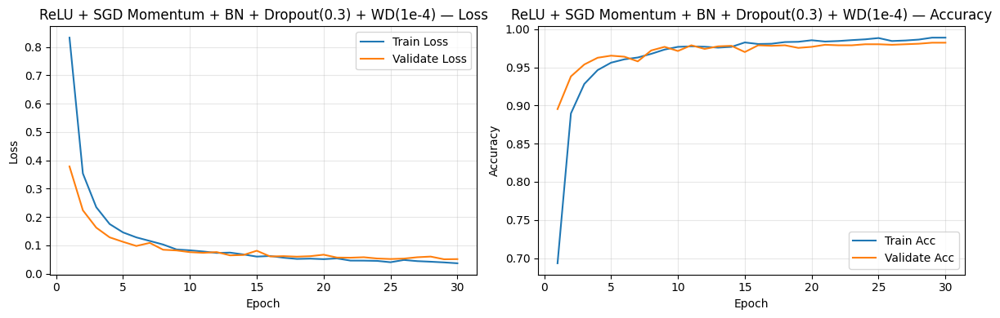


Classification report (validate):
                    precision    recall  f1-score   support

            LAYING       1.00      1.00      1.00       280
           SITTING       0.95      0.97      0.96       262
          STANDING       0.97      0.95      0.96       276
           WALKING       0.99      1.00      0.99       247
WALKING_DOWNSTAIRS       0.99      1.00      0.99       206
  WALKING_UPSTAIRS       0.99      0.98      0.99       200

          accuracy                           0.98      1471
         macro avg       0.98      0.98      0.98      1471
      weighted avg       0.98      0.98      0.98      1471



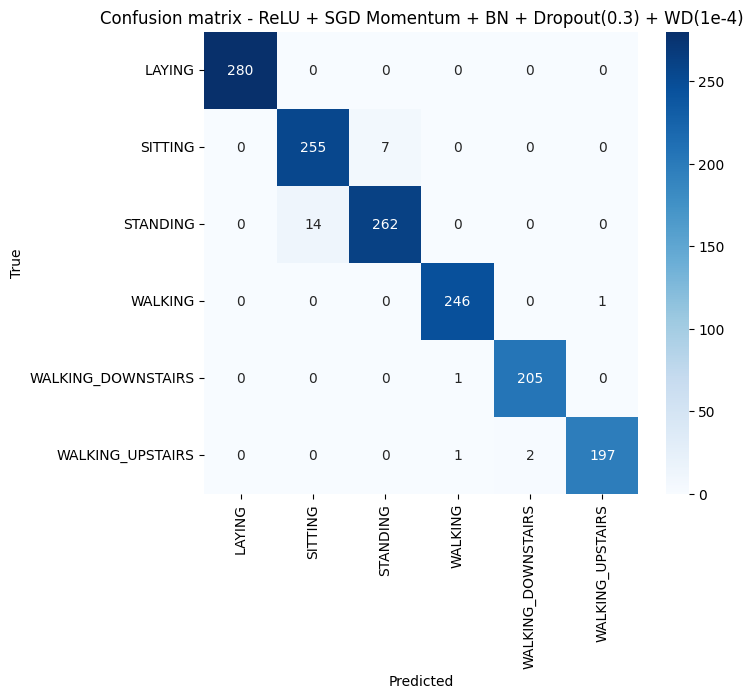


Model: Tanh + Adam + BN + Dropout(0.3) + WD(1e-4)


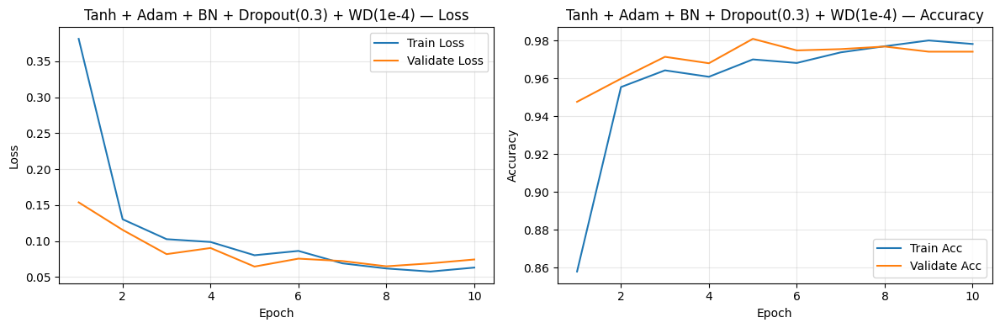


Classification report (validate):
                    precision    recall  f1-score   support

            LAYING       1.00      1.00      1.00       280
           SITTING       0.91      0.99      0.95       262
          STANDING       0.99      0.91      0.95       276
           WALKING       0.99      0.99      0.99       247
WALKING_DOWNSTAIRS       0.98      1.00      0.99       206
  WALKING_UPSTAIRS       0.98      0.97      0.98       200

          accuracy                           0.97      1471
         macro avg       0.98      0.98      0.97      1471
      weighted avg       0.98      0.97      0.97      1471



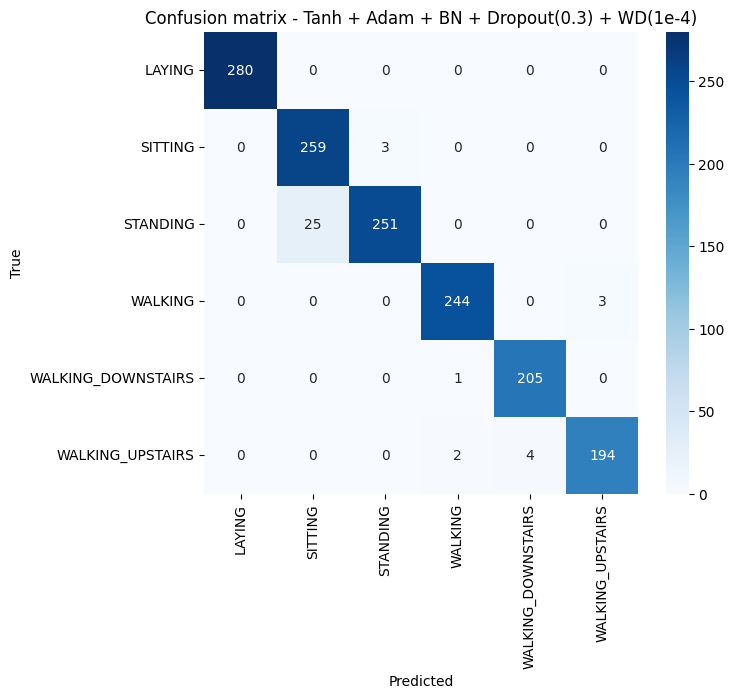

In [57]:
# Classes pour affichage
class_names = ['LAYING','SITTING','STANDING','WALKING','WALKING_DOWNSTAIRS','WALKING_UPSTAIRS']

# Dictionnaire pour stocker les résultats
results = {}

# Évaluation et stockage des infos pour model1
_, _, _, y_true1, y_pred1 = evaluate(model1, valid_loader, criterion, device, return_preds=True)
report1 = classification_report(y_true1, y_pred1, output_dict=True)
results['model1'] = {
    "name": "ReLU + SGD Momentum + BN + Dropout(0.3) + WD(1e-4)",
    "history": hist1,
    "y_true": y_true1,
    "y_pred": y_pred1,
    "report": report1
}

# Évaluation et stockage des infos pour model2
_, _, _, y_true2, y_pred2 = evaluate(model2, valid_loader, criterion, device, return_preds=True)
report2 = classification_report(y_true2, y_pred2, output_dict=True)
results['model2'] = {
    "name": "Tanh + Adam + BN + Dropout(0.3) + WD(1e-4)",
    "history": hist2,
    "y_true": y_true2,
    "y_pred": y_pred2,
    "report": report2
}

# Affichage des courbes + classification report + confusion matrix
for key in ['model1', 'model2']:
    info = results[key]
    print("\n" + "="*80)
    print("Model:", info["name"])
    
    # Courbes d'apprentissage
    plot_learning_curves(info["history"], info["name"])
    
    # Rapport de classification
    print("\nClassification report (validate):")
    print(classification_report(info["y_true"], info["y_pred"], target_names=class_names))
    
    # Matrice de confusion
    plot_confusion_matrix(info["y_true"], info["y_pred"], class_names=class_names, title=f"Confusion matrix - {info['name']}")

In [58]:
# Récapitulatif

rows = []
for key in ['model1','model2']:
    info = results[key]
    hist = info["history"]
   
    if len(hist["f1_macro"])>0:
        best_idx = int(np.argmax(hist["f1_macro"]))
    else:
        best_idx = -1
    rows.append({
        "model": info["name"],
        "best_epoch": best_idx+1 if best_idx>=0 else None,
        "valid_acc_best": hist["test_acc"][best_idx] if best_idx>=0 else None,
        "valid_f1_best": hist["f1_macro"][best_idx] if best_idx>=0 else None,
        "final_valid_acc": info["report"]["accuracy"],
        "final_f1_macro": info["report"]["macro avg"]["f1-score"]
    })

df_summary = pd.DataFrame(rows).sort_values(by="final_f1_macro", ascending=False)
display(df_summary)

,model,best_epoch,valid_acc_best,valid_f1_best,final_valid_acc,final_f1_macro
0,ReLU + SGD Momentum + BN + Dropout(0.3) + WD(1...,29,0.982325,0.983162,0.982325,0.983091
1,Tanh + Adam + BN + Dropout(0.3) + WD(1e-4),5,0.980965,0.981991,0.974167,0.974837


## Partie 6 : Interprétabilité et réduction de dimension

In [59]:
sns.set(style="whitegrid", font_scale=1.05)

In [66]:
def extract_penultimate_activations(model, dataloader, device):
    
    model.eval()
    activations = []
    labels = []
    preds = []
    hook_data = {"features": None}

    layers = [m for m in model.modules() if isinstance(m, torch.nn.Linear)]
    if len(layers) < 2:
        raise RuntimeError("Le modèle doit avoir au moins 2 couches Linear.")
    target_layer = layers[-2]  

    # Hook
    def hook(module, input, output):
        hook_data["features"] = input[0].detach().cpu()

    handle = target_layer.register_forward_hook(hook)

    with torch.no_grad():
        for Xb, yb in dataloader:
            Xb, yb = Xb.to(device), yb.to(device)
            out = model(Xb)

            feats = hook_data["features"]
            if feats is None:
                raise RuntimeError("Hook n'a pas capturé d'activations.")
            activations.append(feats.numpy())

            preds.extend(out.argmax(dim=1).cpu().numpy())
            labels.extend(yb.cpu().numpy())

            hook_data["features"] = None

    handle.remove()
    activations = np.vstack(activations)
    labels = np.array(labels)
    preds = np.array(preds)
    return activations, labels, preds

In [75]:
# t-SNE
def run_tsne(X, perp=30, n_components=2, random_state=0):
    tsne = TSNE(n_components=n_components, perplexity=perp, init='pca', random_state=random_state)
    Z = tsne.fit_transform(X)
    return Z

# UMAP
def run_umap(X, n_neighbors=15, min_dist=0.1, random_state=0):
    import umap
    reducer = umap.UMAP(n_neighbors=n_neighbors, min_dist=min_dist, random_state=random_state)
    Z = reducer.fit_transform(X)
    return Z

# Comparaison : chevauchements vs confusion
def compute_class_overlap_stats(y_true, y_pred):
    stats = []
    uniq = np.unique(y_true)
    for c in uniq:
        idx = np.where(y_true==c)[0]
        n = len(idx)
        n_mis = np.sum(y_pred[idx] != c)
        stats.append((c, n, n_mis, n_mis/n))
    return stats

# Plot embedding
palette = sns.color_palette("tab10", n_colors=6)
def plot_embedding(Z, labels, title=None, class_names=None, preds=None, show_errors=False, figsize=(7,6)):
    plt.figure(figsize=figsize)
    if preds is None:
        plt.scatter(Z[:,0], Z[:,1], c=labels, s=10, cmap='tab10', alpha=0.8)
    else:
        correct_mask = (labels == preds)
        plt.scatter(Z[correct_mask,0], Z[correct_mask,1], c=labels[correct_mask], s=20, cmap='tab10', alpha=0.8)
        plt.scatter(Z[~correct_mask,0], Z[~correct_mask,1], c='none', edgecolor='k', marker='x', s=40, linewidths=0.8)
    plt.title(title)
    if class_names is not None:
        handles = [plt.Line2D([0],[0], marker='o', color='w', label=cname,
                               markerfacecolor=palette[i], markersize=6) for i,cname in enumerate(class_names)]
        plt.legend(handles=handles, bbox_to_anchor=(1.05,1), loc='upper left')
    plt.tight_layout()
    plt.show()

# Affichage centroids sur UMAP / t-SNE
def plot_with_centroids(Z, y, class_names):
    plt.figure(figsize=(8,6))
    plt.scatter(Z[:,0], Z[:,1], c=y, s=8, cmap='tab10', alpha=0.6)
    
    for i, cname in enumerate(class_names):
        idx = np.where(y==i)[0]
        if len(idx)>0:
            cx, cy = Z[idx].mean(axis=0)
            plt.text(cx, cy, cname, fontsize=9, fontweight='bold', bbox=dict(facecolor='white', alpha=0.6))
    plt.title("Projection avec les centroïdes des classes")
    plt.tight_layout()
    plt.show()

### Interpretation des modèles

In [76]:
# Classes HAR
class_names = ['LAYING','SITTING','STANDING','WALKING','WALKING_DOWNSTAIRS','WALKING_UPSTAIRS']

# Fonction pour pipeline complet
def interpretability_pipeline(model, model_name, dataloader, device, class_names):
    print(f"\n{'='*80}\nAnalyse pour {model_name}\n{'='*80}")
    
    # 1. Extraction des activations
    X_acts, y_true, y_pred = extract_penultimate_activations(model, dataloader, device)
    print("Activations shape:", X_acts.shape)
    
    # 2. Matrice de confusion
    cm = confusion_matrix(y_true, y_pred)
    cm_df = pd.DataFrame(cm, index=class_names, columns=class_names)
    print("\nConfusion matrix :")
    display(cm_df)
    
    # Top confusions
    cm_flat = [(i,j,cm[i,j]) for i in range(cm.shape[0]) for j in range(cm.shape[1]) if i!=j]
    cm_flat_sorted = sorted(cm_flat, key=lambda x: x[2], reverse=True)
    print("\nTop confusions (true -> pred) :")
    for (i,j,cnt) in cm_flat_sorted[:6]:
        print(f"  {class_names[i]} -> {class_names[j]} : {cnt}")
    
    # 3. t-SNE
    print("\nExecution de t-SNE ...")
    Z_tsne = run_tsne(X_acts, perp=30, n_components=2, random_state=0)
    plot_embedding(Z_tsne, y_true, title=f"t-SNE ({model_name}) - Labels réels", class_names=class_names)
    plot_embedding(Z_tsne, y_true, title=f"t-SNE ({model_name}) - Erreurs marquées (x)", class_names=class_names, preds=y_pred, show_errors=True)
    
    # 4. UMAP
    try:
        print("\nExecution de UMAP ...")
        Z_umap = run_umap(X_acts, n_neighbors=15, min_dist=0.1, random_state=0)
        plot_embedding(Z_umap, y_true, title=f"UMAP ({model_name}) - Labels réels", class_names=class_names)
        plot_embedding(Z_umap, y_true, title=f"UMAP ({model_name}) - Erreurs marquées (x)", class_names=class_names, preds=y_pred, show_errors=True)
    except Exception as e:
        print("UMAP a échoué :", e)
        Z_umap = None
    
    # 5. Statistiques de chevauchement
    stats = compute_class_overlap_stats(y_true, y_pred)
    print("\nTaux de mauvaise classification par classe :")
    for c, n, n_mis, frac in stats:
        print(f"  {class_names[c]} : {n_mis}/{n} = {frac:.3f}")
    
    # 6. Affichage des centroïdes
    if Z_umap is not None:
        plot_with_centroids(Z_umap, y_true, class_names)
    else:
        plot_with_centroids(Z_tsne, y_true, class_names)


Analyse pour ReLU + SGD Momentum
Activations shape: (1471, 128)

Confusion matrix :


,LAYING,SITTING,STANDING,WALKING,WALKING_DOWNSTAIRS,WALKING_UPSTAIRS
LAYING,280,0,0,0,0,0
SITTING,0,255,7,0,0,0
STANDING,0,14,262,0,0,0
WALKING,0,0,0,246,0,1
WALKING_DOWNSTAIRS,0,0,0,1,205,0
WALKING_UPSTAIRS,0,0,0,1,2,197



Top confusions (true -> pred) :
  STANDING -> SITTING : 14
  SITTING -> STANDING : 7
  WALKING_UPSTAIRS -> WALKING_DOWNSTAIRS : 2
  WALKING -> WALKING_UPSTAIRS : 1
  WALKING_DOWNSTAIRS -> WALKING : 1
  WALKING_UPSTAIRS -> WALKING : 1

Execution de t-SNE ...


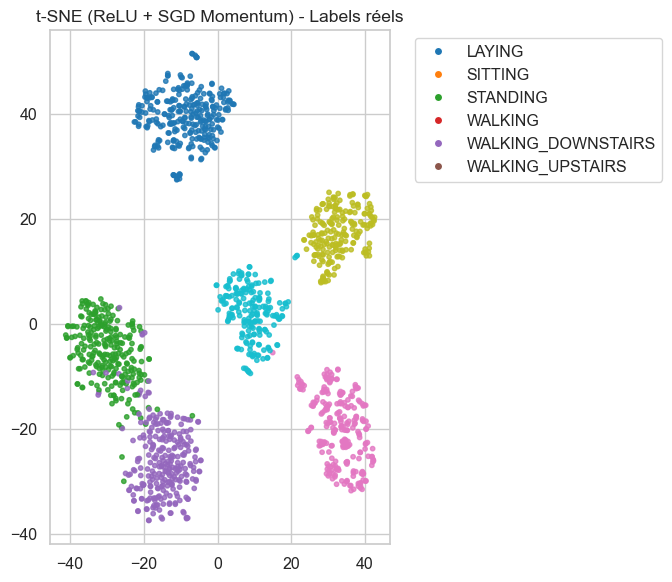

C:\Users\dkone2\AppData\Local\Temp\ipykernel_28244\3135098914.py:34: UserWarning: You passed a edgecolor/edgecolors ('k') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(Z[~correct_mask,0], Z[~correct_mask,1], c='none', edgecolor='k', marker='x', s=40, linewidths=0.8)


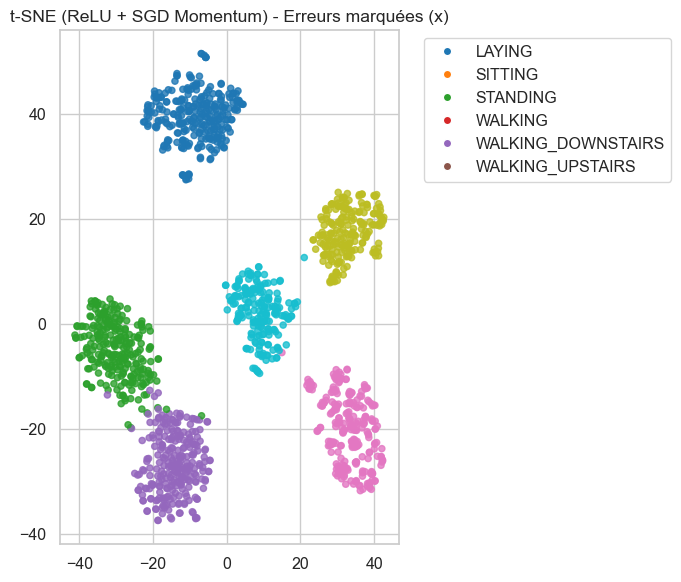


Execution de UMAP ...


C:\Users\dkone2\AppData\Local\anaconda3\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


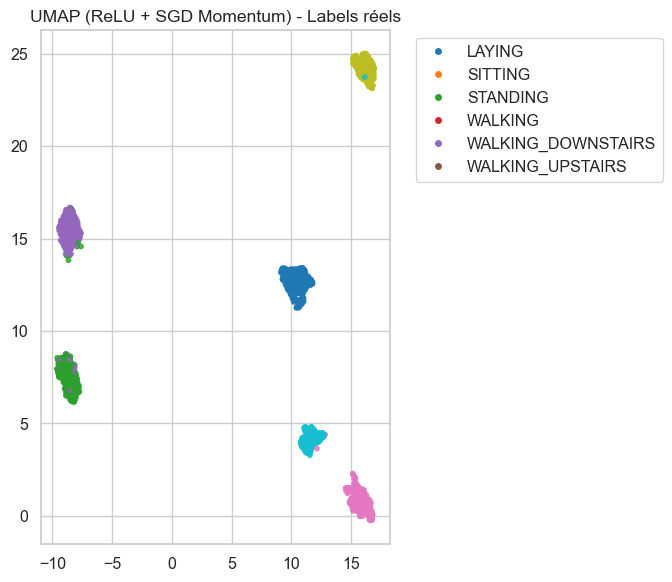

C:\Users\dkone2\AppData\Local\Temp\ipykernel_28244\3135098914.py:34: UserWarning: You passed a edgecolor/edgecolors ('k') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(Z[~correct_mask,0], Z[~correct_mask,1], c='none', edgecolor='k', marker='x', s=40, linewidths=0.8)


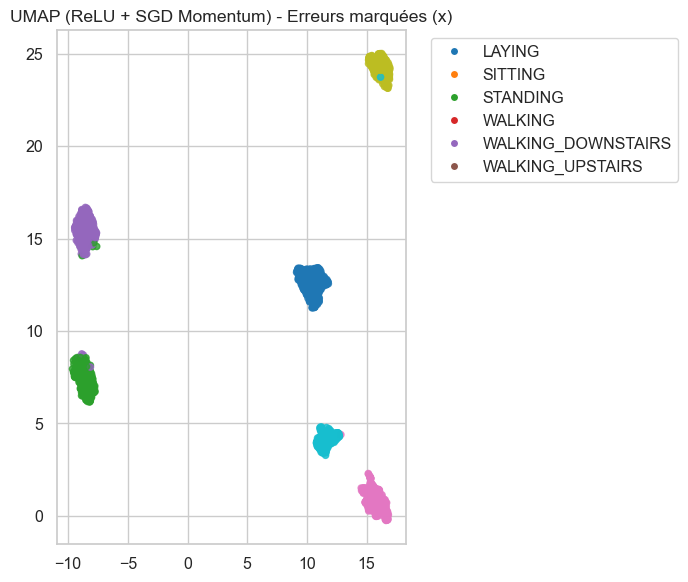


Taux de mauvaise classification par classe :
  LAYING : 0/280 = 0.000
  SITTING : 7/262 = 0.027
  STANDING : 14/276 = 0.051
  WALKING : 1/247 = 0.004
  WALKING_DOWNSTAIRS : 1/206 = 0.005
  WALKING_UPSTAIRS : 3/200 = 0.015


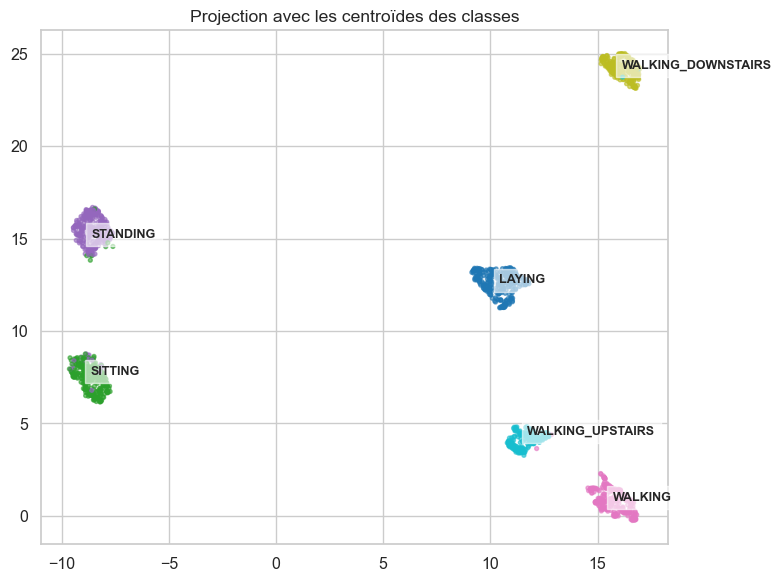

In [77]:
interpretability_pipeline(model1, "ReLU + SGD Momentum", valid_loader, device, class_names)


Analyse pour Tanh + Adam
Activations shape: (1471, 128)

Confusion matrix :


,LAYING,SITTING,STANDING,WALKING,WALKING_DOWNSTAIRS,WALKING_UPSTAIRS
LAYING,280,0,0,0,0,0
SITTING,0,259,3,0,0,0
STANDING,0,25,251,0,0,0
WALKING,0,0,0,244,0,3
WALKING_DOWNSTAIRS,0,0,0,1,205,0
WALKING_UPSTAIRS,0,0,0,2,4,194



Top confusions (true -> pred) :
  STANDING -> SITTING : 25
  WALKING_UPSTAIRS -> WALKING_DOWNSTAIRS : 4
  SITTING -> STANDING : 3
  WALKING -> WALKING_UPSTAIRS : 3
  WALKING_UPSTAIRS -> WALKING : 2
  WALKING_DOWNSTAIRS -> WALKING : 1

Execution de t-SNE ...


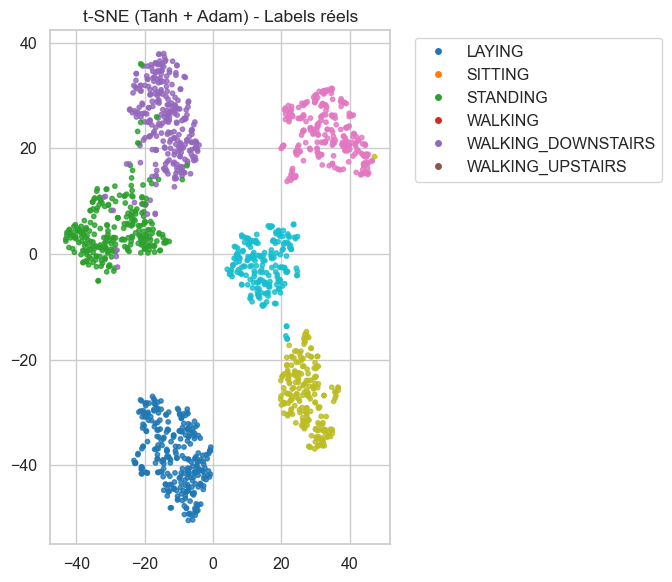

C:\Users\dkone2\AppData\Local\Temp\ipykernel_28244\3135098914.py:34: UserWarning: You passed a edgecolor/edgecolors ('k') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(Z[~correct_mask,0], Z[~correct_mask,1], c='none', edgecolor='k', marker='x', s=40, linewidths=0.8)


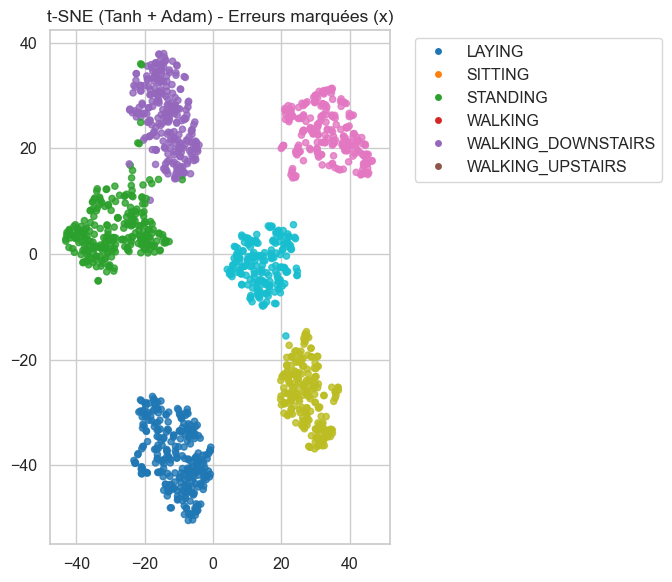


Execution de UMAP ...


C:\Users\dkone2\AppData\Local\anaconda3\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


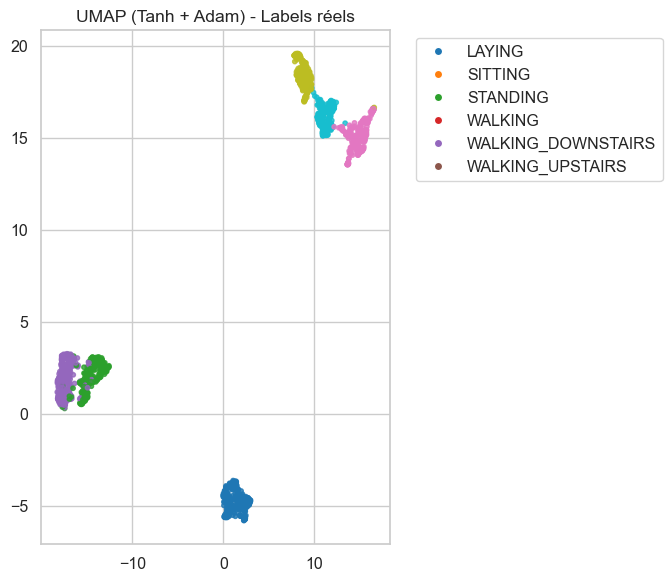

C:\Users\dkone2\AppData\Local\Temp\ipykernel_28244\3135098914.py:34: UserWarning: You passed a edgecolor/edgecolors ('k') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(Z[~correct_mask,0], Z[~correct_mask,1], c='none', edgecolor='k', marker='x', s=40, linewidths=0.8)


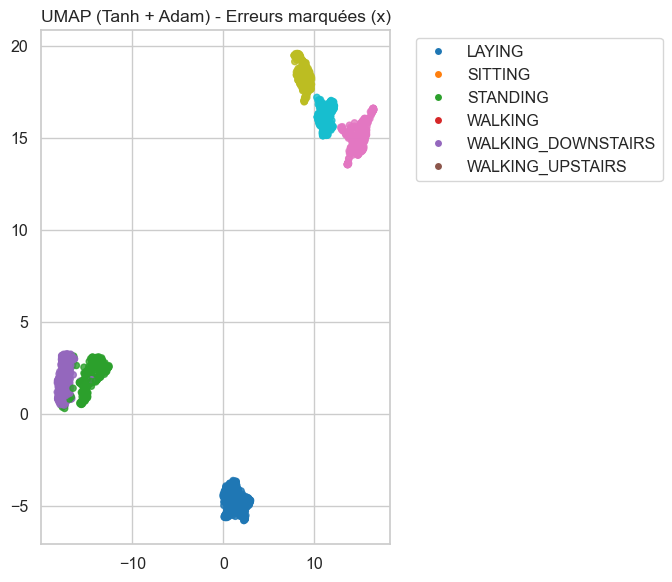


Taux de mauvaise classification par classe :
  LAYING : 0/280 = 0.000
  SITTING : 3/262 = 0.011
  STANDING : 25/276 = 0.091
  WALKING : 3/247 = 0.012
  WALKING_DOWNSTAIRS : 1/206 = 0.005
  WALKING_UPSTAIRS : 6/200 = 0.030


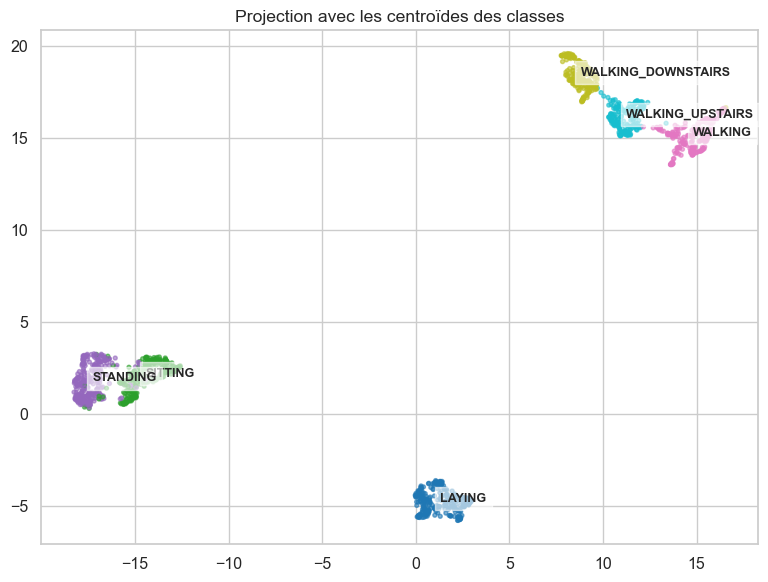

In [78]:
interpretability_pipeline(model2, "Tanh + Adam", valid_loader, device, class_names)

### Performance globale
Les deux modèles montrent une très bonne séparation des classes avec des taux d’erreur faibles.

- ReLU + SGD Momentum est légèrement meilleur en termes de généralisation :

Erreur max : STANDING - SITTING (14 erreurs)
Taux d’erreur STANDING : 5.1 %


- Tanh + Adam présente plus de confusion entre STANDING et SITTING :

Erreur max : STANDING → SITTING (25 erreurs)
Taux d’erreur STANDING : 9.1 %


### Classes faciles vs difficiles

- LAYING : 0 % d’erreur pour les deux modèles, classe parfaitement séparée.
- WALKING, WALKING_DOWNSTAIRS, WALKING_UPSTAIRS : erreurs très faibles (< 1 % pour ReLU, < 3 % pour Tanh).
- SITTING vs STANDING : principale source de confusion pour les deux modèles.
 
Ces deux activités sont statiques et proches en similarité des mouvements, ce qui explique la difficulté.


### Visualisations t-SNE

- Pour ReLU + SGD Momentum :
Les clusters sont bien séparés, avec très peu de points mal classés.
STANDING et SITTING sont proches, ce qui confirme la confusion observée.


- Pour Tanh + Adam :
Clusters également bien séparés, mais STANDING et SITTING se chevauchent davantage, ce qui a peut être une corrélation avec les 25 erreurs.


### Visualisations UMAP

UMAP montre une séparation encore plus nette des clusters pour les deux modèles.
Les erreurs sont concentrées dans les zones de chevauchement entre STANDING et SITTING, et entre WALKING_UPSTAIRS et WALKING_DOWNSTAIRS.



ReLU + SGD Momentum offre la meilleure robustesse :

- Moins de confusion entre STANDING et SITTING.
- Clusters plus compacts et séparés dans t-SNE et UMAP.


Tanh + Adam reste performant mais plus sensible aux confusions statiques (STANDING vs SITTING).
Les deux modèles gèrent très bien les activités dynamiques (WALKING, UPSTAIRS, DOWNSTAIRS).

# ÉVALUATION FINALE DU MODÈLE SUR LE JEU DE TEST

In [79]:
test = pd.read_csv("./HAR/test.csv")

In [80]:
# Encodage de la variable cible 'Activity'

# Encodage des labels
label_encoder = LabelEncoder()
test['Activity_encoded'] = label_encoder.fit_transform(test['Activity'])

# Vérification
label_mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))
print("Mapping des classes :")
print(label_mapping)

# Séparation des colonnes explicatives (X) et la variable cible (y)

X_test = test.drop(columns=['Activity', 'Activity_encoded', 'subject'])
y_test = test['Activity_encoded']

print(f"Dimensions des features (test) : {X_test.shape}")
print(f"Dimensions des labels   (test) : {y_test.shape}")

# Standardisation des variables

scaler = StandardScaler()
X_test_scaled = scaler.fit_transform(X_test)

print("Aperçu après standardisation :")
print(X_test_scaled[:3, :5])


# Conversion en tenseurs PyTorch

X_test_tensor = torch.tensor(X_test_scaled, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test.values, dtype=torch.long)
 
print(f"Tensor features (test) : {X_test_tensor.shape}")
print(f"Tensor labels   (test) : {y_test_tensor.shape}")

# Création des DataLoaders

batch_size = 64

test_dataset = TensorDataset(X_test_tensor, y_test_tensor)
test_loader  = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

print(f"Nombre de batchs de test : {len(test_loader)}")

# Vérification d’un mini-batch
for X_batch, y_batch in test_loader:
    print(f"Batch X : {X_batch.shape}, Batch y : {y_batch.shape}")
    break

Mapping des classes :
{'LAYING': np.int64(0), 'SITTING': np.int64(1), 'STANDING': np.int64(2), 'WALKING': np.int64(3), 'WALKING_DOWNSTAIRS': np.int64(4), 'WALKING_UPSTAIRS': np.int64(5)}
Dimensions des features (test) : (2947, 561)
Dimensions des labels   (test) : (2947,)
Aperçu après standardisation :
[[-0.2777081  -0.21063123  2.19307573 -0.78726748 -0.83321196]
 [ 0.19865964  0.18259066 -0.25026383 -0.87698449 -0.9290609 ]
 [ 0.02458676 -0.31805537 -0.22848456 -0.92159817 -0.93405419]]
Tensor features (test) : torch.Size([2947, 561])
Tensor labels   (test) : torch.Size([2947])
Nombre de batchs de test : 47
Batch X : torch.Size([64, 561]), Batch y : torch.Size([64])


In [81]:
model_final = model1   
model_final.to(device)
model_final.eval()

MLP_FlexLayers_Reg(
  (activation): ReLU()
  (hidden_layers): ModuleList(
    (0): Linear(in_features=561, out_features=128, bias=True)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): Dropout(p=0.3, inplace=False)
    (3): Linear(in_features=128, out_features=128, bias=True)
    (4): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): Dropout(p=0.3, inplace=False)
  )
  (out): Linear(in_features=128, out_features=6, bias=True)
)

In [82]:
# Prédictions sur test

all_preds = []
all_true = []

with torch.no_grad():
    for Xb, yb in test_loader:
        Xb = Xb.to(device)
        out = model_final(Xb)
        preds = out.argmax(dim=1).cpu().numpy()
        all_preds.extend(preds)
        all_true.extend(yb.numpy())

all_preds = np.array(all_preds)
all_true = np.array(all_true)

In [83]:
# Métriques finales

acc = accuracy_score(all_true, all_preds)
f1_macro = f1_score(all_true, all_preds, average="macro")
clf_report = classification_report(all_true, all_preds, target_names=class_names)

print(" METRIQUES FINALES SUR LE JEU DE TEST ")
print(f"Accuracy : {acc:.4f}")
print(f"F1-macro : {f1_macro:.4f}")
print("\nClassification report :")
print(clf_report)

 METRIQUES FINALES SUR LE JEU DE TEST 
Accuracy : 0.9539
F1-macro : 0.9543

Classification report :
                    precision    recall  f1-score   support

            LAYING       1.00      0.98      0.99       537
           SITTING       0.95      0.90      0.93       491
          STANDING       0.89      0.96      0.92       532
           WALKING       0.98      0.95      0.97       496
WALKING_DOWNSTAIRS       0.98      0.96      0.97       420
  WALKING_UPSTAIRS       0.93      0.97      0.95       471

          accuracy                           0.95      2947
         macro avg       0.96      0.95      0.95      2947
      weighted avg       0.96      0.95      0.95      2947



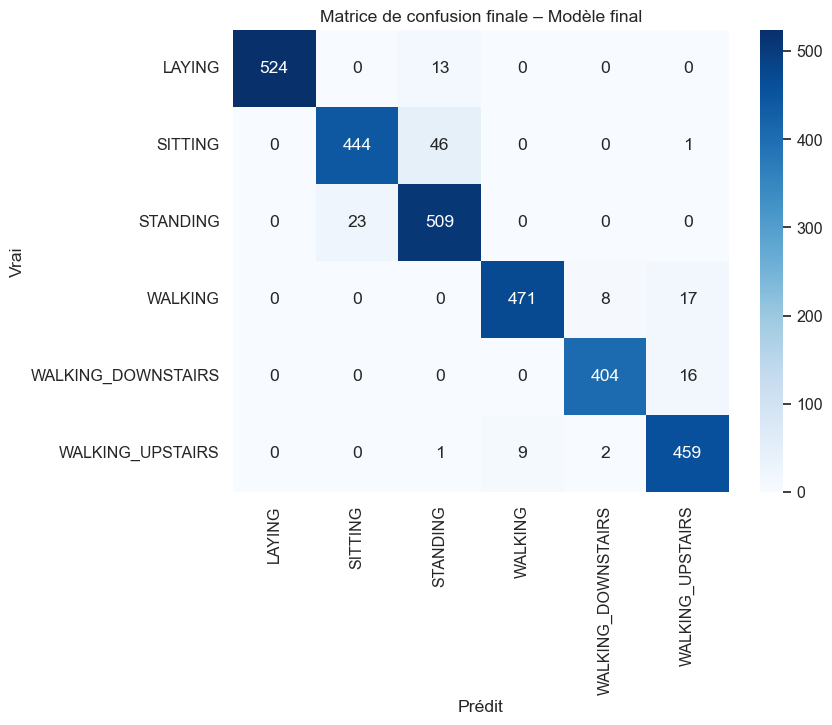

In [84]:
# Matrice de confusion finale

cm = confusion_matrix(all_true, all_preds)
plt.figure(figsize=(8,6))
sns.heatmap(cm, annot=True, cmap="Blues", fmt="d", xticklabels=class_names, yticklabels=class_names)
plt.title("Matrice de confusion finale – Modèle final")
plt.xlabel("Prédit")
plt.ylabel("Vrai")
plt.show()


Analyse pour Prédiction sur le jeu de test
Activations shape: (2947, 128)

Confusion matrix :


,LAYING,SITTING,STANDING,WALKING,WALKING_DOWNSTAIRS,WALKING_UPSTAIRS
LAYING,524,0,13,0,0,0
SITTING,0,444,46,0,0,1
STANDING,0,23,509,0,0,0
WALKING,0,0,0,471,8,17
WALKING_DOWNSTAIRS,0,0,0,0,404,16
WALKING_UPSTAIRS,0,0,1,9,2,459



Top confusions (true -> pred) :
  SITTING -> STANDING : 46
  STANDING -> SITTING : 23
  WALKING -> WALKING_UPSTAIRS : 17
  WALKING_DOWNSTAIRS -> WALKING_UPSTAIRS : 16
  LAYING -> STANDING : 13
  WALKING_UPSTAIRS -> WALKING : 9

Execution de t-SNE ...


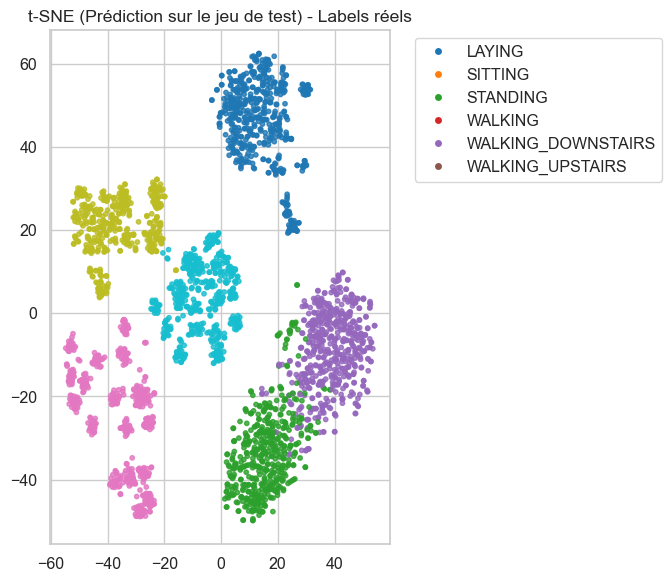

C:\Users\dkone2\AppData\Local\Temp\ipykernel_28244\3135098914.py:34: UserWarning: You passed a edgecolor/edgecolors ('k') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(Z[~correct_mask,0], Z[~correct_mask,1], c='none', edgecolor='k', marker='x', s=40, linewidths=0.8)


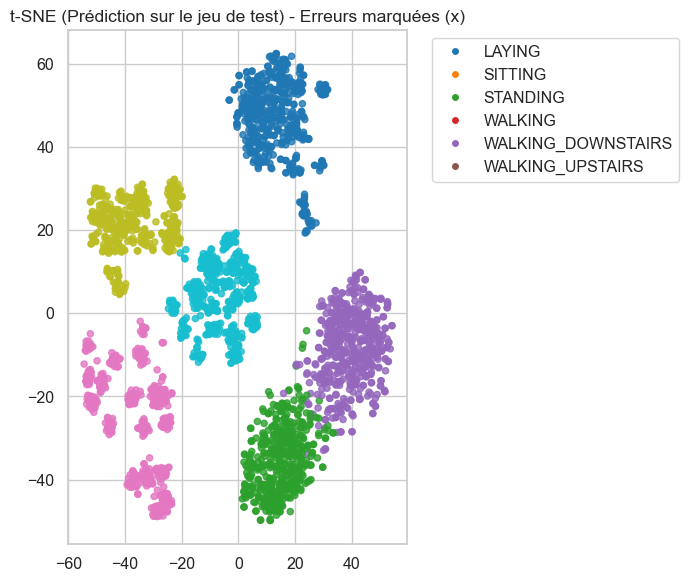


Execution de UMAP ...


C:\Users\dkone2\AppData\Local\anaconda3\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


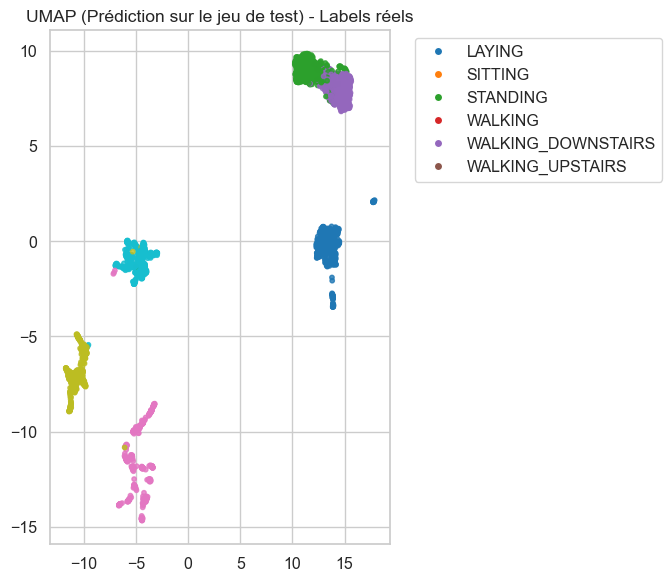

C:\Users\dkone2\AppData\Local\Temp\ipykernel_28244\3135098914.py:34: UserWarning: You passed a edgecolor/edgecolors ('k') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(Z[~correct_mask,0], Z[~correct_mask,1], c='none', edgecolor='k', marker='x', s=40, linewidths=0.8)


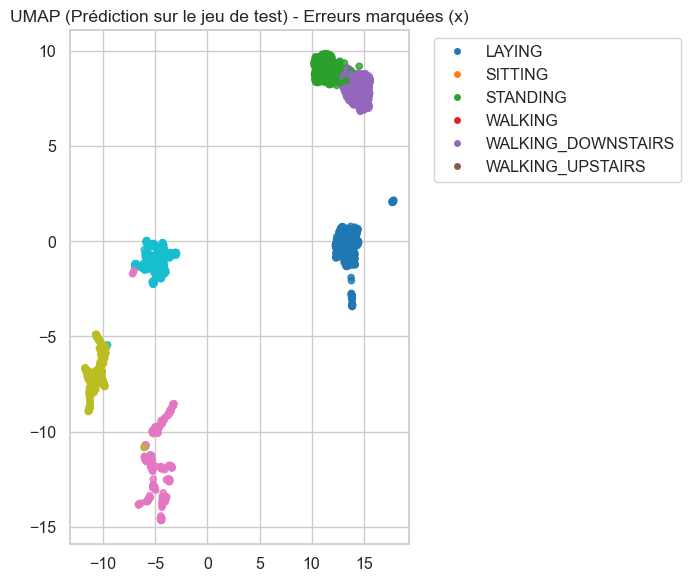


Taux de mauvaise classification par classe :
  LAYING : 13/537 = 0.024
  SITTING : 47/491 = 0.096
  STANDING : 23/532 = 0.043
  WALKING : 25/496 = 0.050
  WALKING_DOWNSTAIRS : 16/420 = 0.038
  WALKING_UPSTAIRS : 12/471 = 0.025


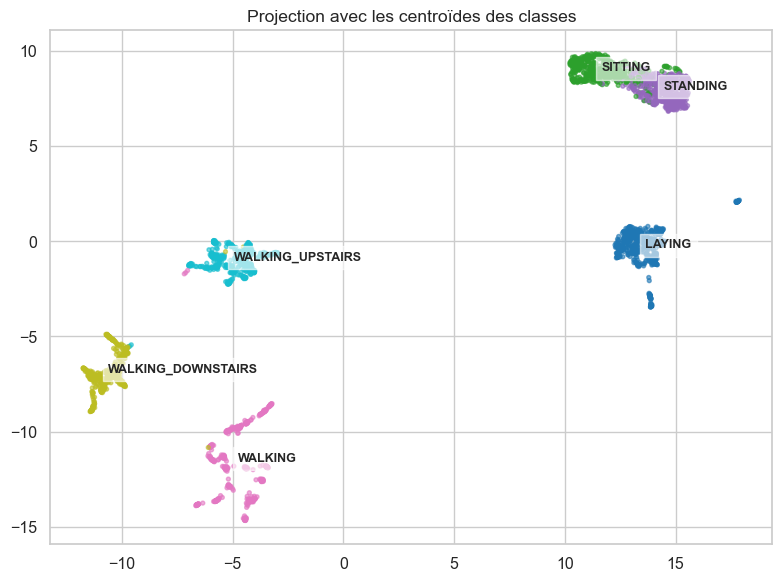

In [86]:
interpretability_pipeline(model_final, "Prédiction sur le jeu de test", test_loader, device, class_names)

In [87]:
# Résumé final des performances

summary_df = pd.DataFrame({
    "Accuracy": [acc],
    "F1-macro": [f1_macro],
    "Nombre d'échantillons test": [len(all_true)]
})

print("\nRésumé final :")
display(summary_df)


Résumé final :


,Accuracy,F1-macro,Nombre d'échantillons test
0,0.953851,0.954261,2947


### Performance globale

Accuracy : 95.39 %, F1-macro : 95.43 % 
Le modèle est robuste, cohérent avec les résultats observés sur le jeu de validation et a un excellent niveau de généralisation.


### Analyse par classe (Classification report)

- LAYING : précision parfaite (1.00), rappel 0.98 
- SITTING vs STANDING :

SITTING : recall = 0.90, f1 = 0.93
STANDING : recall = 0.96, f1 = 0.92
La Confusion entre ces deux postures statiques reste la principale source d’erreur.


- Activités dynamiques (WALKING, UPSTAIRS, DOWNSTAIRS) :
F1 > 0.95, excellente séparation.


 ### Matrice de confusion

Top erreurs :

SITTING - STANDING : 46 erreurs
STANDING - SITTING : 23 erreurs
WALKING - WALKING_UPSTAIRS : 17 erreurs
WALKING_DOWNSTAIRS - WALKING_UPSTAIRS : 16 erreurs

Ces confusions sont logiques car :
- Postures statiques (SITTING/STANDING) très proches en termes de signaux.
- Transitions dynamiques (UPSTAIRS/DOWNSTAIRS) partagent des patterns similaires.


### Taux d’erreur par classe

SITTING : 9.6 % (la plus élevée)
STANDING : 4.3 %
WALKING : 5 %
Autres classes < 4 % : très bon comportement global.


### Visualisations t-SNE et UMAP

- t-SNE :

Clusters bien séparés, mais chevauchement visible entre SITTING et STANDING.
Quelques erreurs marquées dans cette zone.


- UMAP :

Séparation encore plus nette, clusters compacts.
Erreurs concentrées dans zones de chevauchement (SITTING/STANDING, UPSTAIRS/DOWNSTAIRS).


### Conclusion finale

- Le modèle capture efficacement la structure des données.
- Les erreurs sont concentrées sur des classes naturellement proches (postures statiques et transitions dynamiques).